# **04** Modeling / Feature Selection

In [56]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.metrics import r2_score, mean_squared_error
from sklearn.model_selection import train_test_split

import statsmodels.api as sm
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.vector_ar.vecm import VAR
# from statsmodels.tsa.vector_ar.vecm import coint_johansen
# from statsmodels.tsa.stattools import adfuller
# from statsmodels.tsa.seasonal import seasonal_decompose

# from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

In [57]:
# This is a list of all of our routes
routes = pd.read_csv('./data/model/rtm_train_updated.csv')['route'].unique()
print(f'Total Unique Routes: {len(routes)}')
# routes

Total Unique Routes: 375


In [58]:
# This is a placeholder for the routes -- we plan to make 375 different models
itinerary = 'Albany, NY - Chicago, IL'

In [59]:
# Read In Data
def df_read(df_file_path, route):
    
    # Import Dataframe 
    df = pd.read_csv(df_file_path)[pd.read_csv(df_file_path)['route'] == route].dropna(axis=1)
    df.index = pd.to_datetime(df['year-month'])
    df = df.drop(columns=['year-month'])
#     print(df.shape)
    
    # Extract Potential Features
    features = sorted(df.drop(columns=['airfare', 'route', 'pop_origin', 'pop_dest', 'origin_lat', 'origin_long', 'dest_lat', 'dest_long']).columns)
    
    remove_options = [i.replace('sf_', "").replace('_diff_1', "").replace('_diff_2', "") for i in features if "sf_" in i]
    
    features = sorted(set(features) - set(remove_options))
    
    return df, features

### Modeling / Visualization / Analysis Function
- The function below takes in the training dataset & the unseen dataset as well as routes
- It will visualize the results of our model for the test dataset as well as predictions on unseen data
- Additionally it will show us R2, RMSE, and MSE data to compare model/results

In [60]:
# We will be feeding a route specific dataframe
def build_linear_model(train_df, unseen_df, potential_features_list, target_variable='airfare'):
    
    # Which Route are we looking at?
    itinerary = train_df.route.unique()[0]
    print(f'Modeled After Route: {itinerary}')
    
    # model features
    remove_features = [] # Add in items from potential_features_list you do not want to include
    model_features = sorted(set(potential_features_list) - set(remove_features))
    
    # Set X & y variables
    X = train_df[model_features]
    y = train_df[target_variable]
    
    # Train / Test / Split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, shuffle=False)
    
    # Add CONSTANT since we are using statsmodel
    X_train = sm.add_constant(X_train, has_constant='add')
    X_test = sm.add_constant(X_test, has_constant='add')

    # Drop NA values -- statsmodel can't handle
    X_train.dropna(inplace=True)

    # Subset y to match the index from X
    y_train = y_train[X_train.index]

    # Instantiate & fit model
    linear_model = sm.OLS(y_train, X_train).fit()

    print('--------------------')
#     print(linear_model.summary())
    
    # Generate predictions
    y_train_pred = linear_model.predict(X_train)
    y_test_pred = linear_model.predict(X_test)

    # Baseline Series
    y_test_baseline = [y_test.mean()] * len(y_test)
    
    # Scoring
    train_r2 = r2_score(y_train, y_train_pred)
    train_rmse = mean_squared_error(y_train, y_train_pred, squared=False)
    train_mse = mean_squared_error(y_train, y_train_pred)
    test_r2 = r2_score(y_test, y_test_pred)
    test_rmse = mean_squared_error(y_test, y_test_pred, squared=False)
    test_mse = mean_squared_error(y_test, y_test_pred)
    base_r2 = r2_score(y_test, y_test_baseline)
    base_rmse = mean_squared_error(y_test, y_test_baseline, squared=False)
    base_mse = mean_squared_error(y_test, y_test_baseline)
    
#     # Print Scoring
    print('-------------------------')
#     print('Train Analytics')
#     print('-------------------------')
    print(f'     TRAIN R2: {train_r2}')
    print(f'   TRAIN RMSE: {train_rmse}')
# #     print(f'    TRAIN MSE: {train_mse}')
#     print('-------------------------')
#     print('Test Analytics')
    print('-------------------------')
    print(f'      TEST R2: {test_r2}')
    print(f'    TEST RMSE: {test_rmse}')
# #     print(f'     TEST MSE: {test_mse}')
#     print('-------------------------')
#     print('Baseline Analytics')
    print('-------------------------')
    print(f'  Baseline R2: {base_r2}')
    print(f'Baseline RMSE: {base_rmse}')
# #     print(f' Baseline MSE: {base_mse}')
#     print()
    
    # Plot Train/Test & Model Predictions on Training Dataset
    plt.figure(figsize=(12, 4)) # Set figure size.
    plt.grid()                  # add grid
    
    # TRAINING PLOTS
    plt.plot(y_train.index, y_train.values, color = 'blue', label='Training Values')           # Plot training data.
    plt.plot(y_test.index, y_test.values, color = 'orange', label='Test Values', linewidth=10) # Plot testing data.
    plt.plot(y_test_pred, color = 'green', label='Predicted Test Values')                      # Plot predicted test values.

    # TRAINING PLOT COSMETICS
    plt.title(label = 'Train / Test + Predictions: ' + str(itinerary), fontsize=20) # Plot Title
    plt.xticks(fontsize=12)                                                         # Resize X-Ticks
    plt.yticks(fontsize=12)                                                         # Resize Y-Ticks
    plt.ylabel('Airfare Ticket Price ($ USD)', size=12)                             # Y Label
    plt.xlabel('Year-Month', size=12)                                               # X lable
    plt.legend()                                                                    # Legend
    plt.savefig('./visualizations/' + itinerary + '_train_' + str(len(model_features)) + '-features.png', transparent=True, bbox_inches = "tight");
    
# UNSEEN

    X_unseen = unseen_df[model_features]                        # Create X variable with matching features from Traing Data
    X_unseen = sm.add_constant(X_unseen, has_constant='add')    # Add X Constant
    unseen_pred = linear_model.predict(X_unseen)                # Make Predictions -- for 'airfare'
    unseen_df['airfare_predictions'] = unseen_pred              # save predictions to unseen route df
    unseen_df = unseen_df.dropna()                              # dropna values for scoring
    
    # scoring
    unseen_r2 = r2_score(unseen_df.airfare, unseen_df.airfare_predictions)
    unseen_rmse = mean_squared_error(unseen_df.airfare, unseen_df.airfare_predictions, squared=False)
    unseen_mse = mean_squared_error(unseen_df.airfare, unseen_df.airfare_predictions, squared=True)
    
#     # print score
#     print('-------------------------------------------')
#     print('Analytics for Predictions on unseen Data')
    print('-------------------------------------------')
    print(f'      PRED R2: {unseen_r2}')
    print(f'    PRED RMSE: {unseen_rmse}')
# #     print(f'     PRED MSE: {unseen_mse}')
#     print('-------------------------------------------')

    # Plot Predictions on our unseen dataframe
    plt.figure(figsize=(12, 4)) # Set figure size
    plt.grid() ;                 # add grid

    plt.plot(unseen_df['airfare'], color = 'orange', label='Actual Airfare Price', linewidth=10)    # Plot actual data.
    plt.plot(unseen_df['airfare_predictions'], color = 'green', label='Predicted Airfare Price')    # Plot predicted unseen values

    # Unseen Plot Cosmetics
    plt.title(label = 'Predictions (unseen data): ' + str(itinerary), fontsize=20) # add title
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.ylabel('Airfare Ticket Price ($ USD)', size=12)
    plt.xlabel('Year-Month', size=12)
    plt.legend()
    plt.savefig('./visualizations/' + itinerary + '_unseen_' + str(len(model_features)) + '-features.png', transparent=True, bbox_inches = "tight");
    
    # create datafram with the analytics for the route
    model_results = pd.DataFrame(data=[[itinerary, base_r2, train_r2, test_r2, unseen_r2, base_rmse, train_rmse, test_rmse, unseen_rmse]], 
                                 columns=['route', 'base_r2', 'train_r2', 'test_r2', 'unseen_r2', 'base_rmse', 'train_rmse', 'test_rmse', 
                                          'unseen_rmse'])
    # Add in Features
    model_results['model_features'] = [model_features]
    
#     print()
#     print(model_results)
    
    # linear_model returns the model object, results_df returns the invidual route analytics
    return linear_model, model_results

## Create a dictionary to store train & unseen dataframes as well a their potential features
- **THIS WILL TAKE 20 MINUTES TO RUN**

In [95]:
# 20 MIN TO RUN!!!
# Create a dictionary storing all of our route train data, route unseen data, and potential features

all_route_dict = {}
for rte in routes: # only looking at 10 routes right now
    route_dict = {}
    route_dict['route'] = rte
    route_dict['train_dataframe'] = df_read('./data/model/rtm_train_updated.csv', route=rte)[0]
    route_dict['test_dataframe'] = df_read('./data/model/rtm_test_updated.csv', route=rte)[0]
    route_dict['potential_features'] = df_read('./data/model/rtm_train_updated.csv', route=rte)[1]
    all_route_dict[rte] = route_dict

# Taking a look at the dictionary -- looking at the keys of a specific route here
print(itinerary)
print()
all_route_dict[itinerary].keys()

Albany, NY - Chicago, IL



dict_keys(['route', 'train_dataframe', 'test_dataframe', 'potential_features'])

- Let's leverage our functions and run them through a loop of all our our routes
- Each route will have its own custom fit model to make predictions
- Output will be visualizations and scores
- Next Steps:
    - Analyze stats and tune function to output best models

# warning!  this cell will take 15-20 minutes to run!!

Modeled After Route: Albany, NY - Chicago, IL
--------------------
-------------------------
     TRAIN R2: 0.7657307114201463
   TRAIN RMSE: 21.095857834799123
-------------------------
      TEST R2: -11.201212715585347
    TEST RMSE: 51.25559192361639
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 14.67370399350106
-------------------------------------------
      PRED R2: -97.91768738273797
    PRED RMSE: 100.03003323592266
Modeled After Route: Albuquerque, NM - Chicago, IL
--------------------
-------------------------
     TRAIN R2: 0.5045985650257439
   TRAIN RMSE: 8.389440482400703
-------------------------
      TEST R2: -2.6534573529161776
    TEST RMSE: 25.474003060200626
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 13.327392113821649
-------------------------------------------
      PRED R2: -4.248218632839066
    PRED RMSE: 39.04114263175939
Modeled After Route: Albuquerque, NM - Dallas, TX
--------------------
---------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -110.06667230663888
    PRED RMSE: 115.67792358260681
Modeled After Route: Atlanta, GA - Chicago, IL
--------------------
-------------------------
     TRAIN R2: 0.7060694267573091
   TRAIN RMSE: 10.050426923761213
-------------------------
      TEST R2: 0.23664847900971542
    TEST RMSE: 19.1988877462297
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 21.974235860813604


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.381532229695429
    PRED RMSE: 43.188612523298836


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Cincinnati, OH
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 8.003128247955407e-08
-------------------------
      TEST R2: 0.9999989139011163
    TEST RMSE: 0.07891576935824597
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 75.72322660334954


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 6.854384190332682e-08
Modeled After Route: Atlanta, GA - Cleveland, OH
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 8.991470722231153e-08
-------------------------
      TEST R2: 0.9999985928611598
    TEST RMSE: 0.016774093220235153
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 14.140689197214618


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999984345536193
    PRED RMSE: 0.020655924854796014
Modeled After Route: Atlanta, GA - Columbus, OH
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 2.2369288809781994e-09
-------------------------
      TEST R2: 0.9999999999999913
    TEST RMSE: 4.23443765275726e-06
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 45.370049064149505


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 5.048060185593184e-07


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Dallas, TX
--------------------
-------------------------
     TRAIN R2: 0.9999998535345683
   TRAIN RMSE: 0.008292413236902538
-------------------------
      TEST R2: 0.999994003042694
    TEST RMSE: 0.04288657896967013
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 17.512813622380104


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999904589237029
    PRED RMSE: 0.04593563712548975
Modeled After Route: Atlanta, GA - Detroit, MI


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.7455242663777668
   TRAIN RMSE: 9.257291452615734
-------------------------
      TEST R2: -5.480552959662993
    TEST RMSE: 25.426843204323635
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.988181210254893


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -16.561859680935
    PRED RMSE: 40.00185035780356
Modeled After Route: Atlanta, GA - Hartford, CT
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 8.634950159089138e-08
-------------------------
      TEST R2: 1.0
    TEST RMSE: 8.696777134850626e-08
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 48.70578498466299


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 7.739591647566796e-08
Modeled After Route: Atlanta, GA - Houston, TX
--------------------
-------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



     TRAIN R2: 0.9999997126822562
   TRAIN RMSE: 0.013178932298079121
-------------------------
      TEST R2: 0.9999887089790664
    TEST RMSE: 0.057009758447669125
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 16.96612235128843
-------------------------------------------
      PRED R2: 0.9999738816729992
    PRED RMSE: 0.05613708550756191
Modeled After Route: Atlanta, GA - Indianapolis, IN


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.9092651543080958
   TRAIN RMSE: 6.341379311197416
-------------------------
      TEST R2: -1.3364547523592614
    TEST RMSE: 64.71585828859389
-------------------------
  Baseline R2: 4.440892098500626e-16
Baseline RMSE: 42.338164684937496


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -110.0180063902639
    PRED RMSE: 102.50776113435617
Modeled After Route: Atlanta, GA - Jacksonville, FL
--------------------
-------------------------
     TRAIN R2: 0.23730022310698962
   TRAIN RMSE: 8.244643433551323
-------------------------
      TEST R2: -3.548187847610018
    TEST RMSE: 36.34643805871704
-------------------------
  Baseline R2: 6.661338147750939e-16
Baseline RMSE: 17.042867194877225


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -12.374674617030452
    PRED RMSE: 38.03788438108172


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Kansas City, MO
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 2.1768452325802439e-10
-------------------------
      TEST R2: 1.0
    TEST RMSE: 2.309216188532156e-10
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 8.765847038681182


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 2.675307010788476e-10


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Las Vegas, NV
--------------------
-------------------------
     TRAIN R2: 0.42859016056914157
   TRAIN RMSE: 21.206561542007137
-------------------------
      TEST R2: -5.860308465101644
    TEST RMSE: 55.17268886113279
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 21.06455690582854


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -431.5693640156895
    PRED RMSE: 145.4785191270096


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 0.5757532753962189
   TRAIN RMSE: 28.88771042583037
-------------------------
      TEST R2: -21.846731124739275
    TEST RMSE: 122.9906971463645
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 25.731211106358753


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1477.836775922351
    PRED RMSE: 339.8540783909446


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Memphis, TN
--------------------
-------------------------
     TRAIN R2: 0.6223001344705696
   TRAIN RMSE: 5.131578270737085
-------------------------
      TEST R2: -1.59002972571537
    TEST RMSE: 18.199756902703694
-------------------------
  Baseline R2: -6.661338147750939e-16
Baseline RMSE: 11.308713792420823


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -12.40701579179012
    PRED RMSE: 40.655387493468275


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Miami, FL
--------------------
-------------------------
     TRAIN R2: 0.4088971897690509
   TRAIN RMSE: 8.401533962344464
-------------------------
      TEST R2: -3.9077950594541546
    TEST RMSE: 24.178572426827408
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.914087863348401


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.6594596437483502
    PRED RMSE: 16.399591171600612


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Milwaukee, WI
--------------------
-------------------------
     TRAIN R2: 0.5420953804528165
   TRAIN RMSE: 32.40703945806544
-------------------------
      TEST R2: -115.70622512502668
    TEST RMSE: 81.62312988560103
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 7.555552593953667


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -155.75296458605038
    PRED RMSE: 122.89814293629075


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.1500690573705219
   TRAIN RMSE: 35.77274489796899
-------------------------
      TEST R2: -28.373342876169378
    TEST RMSE: 50.38032894581538
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.295747347577816


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -74.49538658664075
    PRED RMSE: 109.52291061000973
Modeled After Route: Atlanta, GA - New Orleans, LA
--------------------
-------------------------
     TRAIN R2: 0.42944459280769487
   TRAIN RMSE: 6.708215379487925
-------------------------
      TEST R2: -6.231822932982056
    TEST RMSE: 59.80926997581447
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 22.240503216729014


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -6.092698811691336
    PRED RMSE: 34.005291078866605


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.7715853355277876
   TRAIN RMSE: 8.980282431892766
-------------------------
      TEST R2: -2.3834056984734335
    TEST RMSE: 23.791429289845283
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 12.934316838678937


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -13.307033721563304
    PRED RMSE: 32.79798876713223


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.4229058549872263
   TRAIN RMSE: 10.383901098850238
-------------------------
      TEST R2: -3.4455293331601915
    TEST RMSE: 28.24372901341815
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 13.39554216894561


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.457982882684208
    PRED RMSE: 13.835980369182984


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.6280313653828177
   TRAIN RMSE: 4.4850832942610115
-------------------------
      TEST R2: -0.8857622471242081
    TEST RMSE: 22.932862504282156
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 16.699935690993943


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -9.837575989020037
    PRED RMSE: 42.263219010747626
Modeled After Route: Atlanta, GA - Phoenix, AZ


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.38966434453244037
   TRAIN RMSE: 25.85916257040445
-------------------------
      TEST R2: -3.2965181363548766
    TEST RMSE: 45.3168609010282
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 21.86258414315807


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -75.1088350823368
    PRED RMSE: 105.31878501693922
Modeled After Route: Atlanta, GA - Pittsburgh, PA
--------------------
-------------------------
     TRAIN R2: 0.23512219435938264
   TRAIN RMSE: 53.69147763409251
-------------------------
      TEST R2: -23.287454571102742
    TEST RMSE: 89.2908336099453
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 18.118234522773516


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -71.30559686282668
    PRED RMSE: 80.9487560723429
Modeled After Route: Atlanta, GA - Portland, OR
--------------------
-------------------------
     TRAIN R2: 0.5409139553554716
   TRAIN RMSE: 21.855846895751498
-------------------------
      TEST R2: -2.9709989247588977
    TEST RMSE: 66.89620701108068
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 33.570020727825984


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -20.562302681122553
    PRED RMSE: 101.16268123380344


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Raleigh, NC
--------------------
-------------------------
     TRAIN R2: 0.6253753771748025
   TRAIN RMSE: 8.291429565487407
-------------------------
      TEST R2: -9.138096607882394
    TEST RMSE: 60.05102077488946
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 18.8600214114112


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -3.07028100433386
    PRED RMSE: 30.95882548466221


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Richmond, VA
--------------------
-------------------------
     TRAIN R2: 0.8481060836041311
   TRAIN RMSE: 14.424934428782034
-------------------------
      TEST R2: -5.834176617953918
    TEST RMSE: 106.24420193809766
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 40.64078982035441


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -245.76597090245116
    PRED RMSE: 133.67335209276067


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Salt Lake City, UT
--------------------
-------------------------
     TRAIN R2: 0.702028837105328
   TRAIN RMSE: 5.664147899959868
-------------------------
      TEST R2: -0.9372499085929509
    TEST RMSE: 38.87386304916815
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 27.929610282915792


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -11.561154404297943
    PRED RMSE: 70.58497285801971
Modeled After Route: Atlanta, GA - San Antonio, TX
--------------------
-------------------------
     TRAIN R2: 0.6103289578371531
   TRAIN RMSE: 9.26681486950606
-------------------------
      TEST R2: -1.6767249759309073
    TEST RMSE: 37.23440635753357
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 22.758443610131945


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -10.555510630369644
    PRED RMSE: 120.58516325687859
Modeled After Route: Atlanta, GA - San Francisco, CA


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.9378257925104098
   TRAIN RMSE: 13.974631330252992
-------------------------
      TEST R2: -14.089791975714471
    TEST RMSE: 121.62683107893108
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 31.310338670140396


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -194.20013239323762
    PRED RMSE: 131.74268816175166
Modeled After Route: Atlanta, GA - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.3543932302871854
   TRAIN RMSE: 27.219657917145646
-------------------------
      TEST R2: -5.574361199990509
    TEST RMSE: 49.04912585767208
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 19.129538441170567


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -20.59415281295967
    PRED RMSE: 150.67689790435836


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.33310512246869006
   TRAIN RMSE: 12.723253005595808
-------------------------
      TEST R2: -0.5381881783097502
    TEST RMSE: 33.49715955378241
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 27.008673028307033


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -114.14198609387203
    PRED RMSE: 87.785512002059


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.20560848738509196
   TRAIN RMSE: 10.406178992881673
-------------------------
      TEST R2: -2.687745339842118
    TEST RMSE: 32.55055198064669
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 16.95031978967424


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -6.001702849175662
    PRED RMSE: 29.98305429187922


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Atlanta, GA - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.8885754277955771
   TRAIN RMSE: 4.81861934171928
-------------------------
      TEST R2: -0.025512126153828474
    TEST RMSE: 17.816652509466056
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 17.593640344043514
-------------------------------------------
      PRED R2: -2.568652192952605
    PRED RMSE: 23.310178082744613


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Austin, TX - Chicago, IL
--------------------
-------------------------
     TRAIN R2: 0.8437202845758539
   TRAIN RMSE: 10.328007296318475
-------------------------
      TEST R2: -11.463094729968999
    TEST RMSE: 39.14222331473335
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.087472159554173


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -15.39183966231936
    PRED RMSE: 32.136307070327504
Modeled After Route: Austin, TX - Dallas, TX


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.7357394909028063
   TRAIN RMSE: 3.7000736522279465
-------------------------
      TEST R2: -17.837744988299107
    TEST RMSE: 13.769191693978968
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 3.172444181279369


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -13.90143060158284
    PRED RMSE: 17.339320268162567


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Austin, TX - El Paso, TX
--------------------
-------------------------
     TRAIN R2: 0.9999990844769847
   TRAIN RMSE: 0.005800640215137063
-------------------------
      TEST R2: 0.9999597212972063
    TEST RMSE: 0.048548718936646515
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 7.649623084396601


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.999915559762864
    PRED RMSE: 0.08493924657011008


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Austin, TX - Houston, TX
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 5.270182468644047e-10
-------------------------
      TEST R2: 1.0
    TEST RMSE: 7.245972841106037e-10
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 3.2722159498147767


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.1906938469820406e-09


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Austin, TX - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.6333627304726668
   TRAIN RMSE: 4.6313193769093495
-------------------------
      TEST R2: -2.205460990321153
    TEST RMSE: 27.287450697800942
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 15.241149253109349


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -14.7838476101314
    PRED RMSE: 35.11511739315607


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Boston, MA - Charlotte, NC
--------------------
-------------------------
     TRAIN R2: 0.8887744596467123
   TRAIN RMSE: 7.353737665087423
-------------------------
      TEST R2: 0.6291339260735163
    TEST RMSE: 26.276131497653644
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 43.14722537590208


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -2.8644783300166226
    PRED RMSE: 49.70932403718563
Modeled After Route: Boston, MA - Chicago, IL
--------------------
-------------------------
     TRAIN R2: 0.643070291365347
   TRAIN RMSE: 14.705230948429719
-------------------------
      TEST R2: -23.661001870359147
    TEST RMSE: 48.521123920967206
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 9.77069584125011


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -2.8810761103815796
    PRED RMSE: 34.02286250403157
Modeled After Route: Boston, MA - Cincinnati, OH
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.1989499755284566e-07
-------------------------
      TEST R2: 1.0
    TEST RMSE: 1.3375899564583537e-07
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 51.51214945686761


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.3307587107065594e-07
Modeled After Route: Boston, MA - Cleveland, OH


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.6862997086766297
   TRAIN RMSE: 10.292515224883818
-------------------------
      TEST R2: -5.940509145585532
    TEST RMSE: 87.21416370967795
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 33.104829487805354


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -3.2692883503379075
    PRED RMSE: 30.714711233245197
Modeled After Route: Boston, MA - Dallas, TX


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.7235888380134918
   TRAIN RMSE: 22.87908018590601
-------------------------
      TEST R2: -1.9534245957850365
    TEST RMSE: 56.305879619685776
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 32.76353879399409


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -7.925866141413984
    PRED RMSE: 119.61600369263385


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Boston, MA - Detroit, MI
--------------------
-------------------------
     TRAIN R2: 0.9999990602715436
   TRAIN RMSE: 0.021186839506478983
-------------------------
      TEST R2: 0.9999993099591991
    TEST RMSE: 0.033880558659231466
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 40.78619370843794


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999959784473725
    PRED RMSE: 0.03727773821669294


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Boston, MA - Houston, TX
--------------------
-------------------------
     TRAIN R2: 0.7021811944742066
   TRAIN RMSE: 17.159732340224632
-------------------------
      TEST R2: -1.6746434953143856
    TEST RMSE: 34.60623218360246
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 21.16027784159115


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -21.07237700240676
    PRED RMSE: 83.92033458486186
Modeled After Route: Boston, MA - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 0.9677145011210287
   TRAIN RMSE: 5.480930655645208
-------------------------
      TEST R2: -0.8160537835327897
    TEST RMSE: 36.141174106546
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 26.818711233432197


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.1494200061687906
    PRED RMSE: 35.97219317657586


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Boston, MA - Miami, FL
--------------------
-------------------------
     TRAIN R2: 0.9999999999999997
   TRAIN RMSE: 1.6007649133274717e-07
-------------------------
      TEST R2: 0.9999999999999999
    TEST RMSE: 1.3500427936969707e-07
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 15.18046277291967


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9998300115623823
    PRED RMSE: 0.09125829265303374
Modeled After Route: Boston, MA - Milwaukee, WI
--------------------
-------------------------
     TRAIN R2: 0.6435615657440031
   TRAIN RMSE: 15.701039428619444
-------------------------
      TEST R2: -22.01398935499475
    TEST RMSE: 43.767014612847845
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.123279289816791


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.4874290252291789
    PRED RMSE: 38.307207242479684


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Boston, MA - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.1318532547351746e-07
-------------------------
      TEST R2: 1.0
    TEST RMSE: 8.948431365466329e-08
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 31.812064884603476


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.0182666939506077e-07
Modeled After Route: Boston, MA - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.4915305965610379
   TRAIN RMSE: 4.303976904820256
-------------------------
      TEST R2: -0.6808284462444247
    TEST RMSE: 10.691259279225736
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 8.246452604335726


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -5.417238850606211
    PRED RMSE: 47.11805643544281
Modeled After Route: Boston, MA - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.9999999999999998
   TRAIN RMSE: 1.4226415699192552e-07
-------------------------
      TEST R2: 0.999963221834467
    TEST RMSE: 0.08188864732118857
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 13.502950192046509


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999067803244484
    PRED RMSE: 0.07713257138101572
Modeled After Route: Boston, MA - Philadelphia, PA


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.47916955134478045
   TRAIN RMSE: 23.599759980015502
-------------------------
      TEST R2: -40.97025760286842
    TEST RMSE: 74.66362490381202
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 11.524928868182513


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -26.85915745501724
    PRED RMSE: 54.07943770423084
Modeled After Route: Boston, MA - Pittsburgh, PA
--------------------
-------------------------
     TRAIN R2: 0.6684923271178053
   TRAIN RMSE: 10.537741824402232
-------------------------
      TEST R2: -0.42744693661866373
    TEST RMSE: 51.363822723084944
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 42.99098066746094


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -58.11944913597304
    PRED RMSE: 84.5900303795131
Modeled After Route: Boston, MA - Raleigh, NC


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.5547417956593699
   TRAIN RMSE: 19.995829146791802
-------------------------
      TEST R2: -0.5286517682848595
    TEST RMSE: 25.736813106116923
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 20.816153766699763
-------------------------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



      PRED R2: -1.9021848564630264
    PRED RMSE: 30.62971641494435
Modeled After Route: Boston, MA - Richmond, VA
--------------------
-------------------------
     TRAIN R2: 0.44664418545543216
   TRAIN RMSE: 17.574630821322486
-------------------------
      TEST R2: -1.138114468029087
    TEST RMSE: 36.24765919991859
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 24.789312927482822


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -8.371116000725378
    PRED RMSE: 37.85121810493296
Modeled After Route: Boston, MA - Salt Lake City, UT


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.3621484429313082
   TRAIN RMSE: 13.504825571987837
-------------------------
      TEST R2: -1.3096030157085607
    TEST RMSE: 41.6070740916745
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 27.37779752321619


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.7544596977018228
    PRED RMSE: 28.89339580120812
Modeled After Route: Boston, MA - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.3979223072673782
   TRAIN RMSE: 39.01607453420758
-------------------------
      TEST R2: -20.623257239963298
    TEST RMSE: 129.333018789563
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 27.813065412479958


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -16.867767940499466
    PRED RMSE: 140.37326492375857
Modeled After Route: Boston, MA - St. Louis, MO


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.5134578173319818
   TRAIN RMSE: 23.69180356630488
-------------------------
      TEST R2: -6.616689947195714
    TEST RMSE: 45.87990908863319
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 16.624148516206446


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.256363918190969
    PRED RMSE: 60.781199990214226
Modeled After Route: Boston, MA - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.9999999999999999
   TRAIN RMSE: 7.196385976731828e-08
-------------------------
      TEST R2: 1.0
    TEST RMSE: 8.423536543685158e-08
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 13.430913631329116


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999999999999998
    PRED RMSE: 1.0294898767055596e-07


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Boston, MA - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.9999975658017183
   TRAIN RMSE: 0.01541470646799322
-------------------------
      TEST R2: 0.9999884263313127
    TEST RMSE: 0.025373258822933644
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 7.458315083776556


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9998719918658465
    PRED RMSE: 0.07674902737563166
Modeled After Route: Buffalo, NY - Chicago, IL
--------------------
-------------------------
     TRAIN R2: 0.7967161092165573
   TRAIN RMSE: 18.686027746703136
-------------------------
      TEST R2: -0.31391883155661615
    TEST RMSE: 46.402405302195255
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 40.48146533188574


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -88.96468486198997
    PRED RMSE: 90.89345077295266
Modeled After Route: Buffalo, NY - New York, NY


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.7840155715966846
   TRAIN RMSE: 10.59257854667093
-------------------------
      TEST R2: -18.427569455690932
    TEST RMSE: 30.24756982122405
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 6.862482543997229


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -36.04275122252893
    PRED RMSE: 59.24691408950552


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Charlotte, NC - Chicago, IL
--------------------
-------------------------
     TRAIN R2: 0.953201826226829
   TRAIN RMSE: 10.43231770615226
-------------------------
      TEST R2: -0.8190072235029582
    TEST RMSE: 33.53298850167732
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 24.8630869155908


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -51.45901000294624
    PRED RMSE: 104.94114676191768


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Charlotte, NC - Dallas, TX
--------------------
-------------------------
     TRAIN R2: 0.26526073926639726
   TRAIN RMSE: 26.27139949456787
-------------------------
      TEST R2: -4.813756284323477
    TEST RMSE: 72.40997420361485
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 30.03101298611524


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.378650120696568
    PRED RMSE: 67.77501098947997


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Charlotte, NC - Detroit, MI
--------------------
-------------------------
     TRAIN R2: 0.5580831442222108
   TRAIN RMSE: 14.9809470623614
-------------------------
      TEST R2: -1.0157866959968005
    TEST RMSE: 42.73957762488161
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 30.102872463530044


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -230.6199312923835
    PRED RMSE: 102.88002472117768
Modeled After Route: Charlotte, NC - Houston, TX
--------------------
-------------------------
     TRAIN R2: 0.8110737487756672
   TRAIN RMSE: 12.78190680241646
-------------------------
      TEST R2: -1.9846418434392898
    TEST RMSE: 72.861175638525
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 42.17451167964682


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -54.9734263765093
    PRED RMSE: 133.60320369499962


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Charlotte, NC - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 0.7174090687698873
   TRAIN RMSE: 16.86406813367307
-------------------------
      TEST R2: -5.052558040289267
    TEST RMSE: 47.76805974046968
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 19.416373602938545


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -14.06008893018692
    PRED RMSE: 92.20712083499205
Modeled After Route: Charlotte, NC - Miami, FL
--------------------
-------------------------
     TRAIN R2: 0.8225360860027391
   TRAIN RMSE: 5.855752329075304
-------------------------
      TEST R2: -3.0391619077879035
    TEST RMSE: 20.56409184862568
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 10.232079456298216


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -11.457319153230172
    PRED RMSE: 69.24397760247031


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Charlotte, NC - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.41818488254135533
   TRAIN RMSE: 23.017362528021856
-------------------------
      TEST R2: -17.70312374717662
    TEST RMSE: 73.18291654452004
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 16.922036975986867


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -76.10735054056858
    PRED RMSE: 92.27043462616138
Modeled After Route: Charlotte, NC - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.7624492245435539
   TRAIN RMSE: 9.172123987398422
-------------------------
      TEST R2: -1.0688151032717452
    TEST RMSE: 79.98554655900587
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 55.60971607751853


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -96.93221817211307
    PRED RMSE: 153.08568275867108
Modeled After Route: Charlotte, NC - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.7977284723096973
   TRAIN RMSE: 8.925666208522507
-------------------------
      TEST R2: -138.79166467349143
    TEST RMSE: 82.28497459842924
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 6.959529837248743


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -3.341930380607968
    PRED RMSE: 35.43526715508521
Modeled After Route: Charlotte, NC - Philadelphia, PA


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.6284710545363857
   TRAIN RMSE: 12.442472712217233
-------------------------
      TEST R2: -1.5839680812514048
    TEST RMSE: 49.033685989131634
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 30.503590999895227


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -68.86258434793882
    PRED RMSE: 242.01899407963597
Modeled After Route: Charlotte, NC - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.3505901532394754
   TRAIN RMSE: 39.5208787489655
-------------------------
      TEST R2: -17.062567046815825
    TEST RMSE: 110.41582036655437
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 25.98014480917217


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -17.122231721492216
    PRED RMSE: 117.34564525481535
Modeled After Route: Charlotte, NC - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.5606958706996339
   TRAIN RMSE: 11.348406548060684
-------------------------
      TEST R2: -16.531609948149967
    TEST RMSE: 61.07873972755155
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 14.587442849550053


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.270961263491015
    PRED RMSE: 48.17501623375049


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Charlotte, NC - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.7008470540098252
   TRAIN RMSE: 9.597692435371513
-------------------------
      TEST R2: -2.250202426858945
    TEST RMSE: 105.85984915745854
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 58.7186504774155


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -9.340990286391763
    PRED RMSE: 83.45160135700375
Modeled After Route: Chicago, IL - Cincinnati, OH
--------------------
-------------------------
     TRAIN R2: 0.6759415557135722
   TRAIN RMSE: 26.5287575141763
-------------------------
      TEST R2: -0.27629820583186326
    TEST RMSE: 49.441251095820995
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 43.763633518596244


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.046843204806833905
    PRED RMSE: 57.70362183641032


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Cleveland, OH
--------------------
-------------------------
     TRAIN R2: 0.9999988109989636
   TRAIN RMSE: 0.0072021828852023816
-------------------------
      TEST R2: 0.999992942846126
    TEST RMSE: 0.012929604160685183
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 4.867101864103067


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999460343746416
    PRED RMSE: 0.04930806050962546
Modeled After Route: Chicago, IL - Columbus, OH
--------------------
-------------------------
     TRAIN R2: 0.9999926995639037
   TRAIN RMSE: 0.022796035366589754
-------------------------
      TEST R2: 0.9999503050171773
    TEST RMSE: 0.04428687245272102
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 6.282300976199372


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999051516474483
    PRED RMSE: 0.03640128663505398


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Dallas, TX
--------------------
-------------------------
     TRAIN R2: 0.7213968982665181
   TRAIN RMSE: 12.443752440121886
-------------------------
      TEST R2: -0.5337400307749098
    TEST RMSE: 20.164409324672544
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 16.28207040479394


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -74.02099656595917
    PRED RMSE: 63.28900757911995
Modeled After Route: Chicago, IL - Detroit, MI
--------------------
-------------------------
     TRAIN R2: 0.9999989757797633
   TRAIN RMSE: 0.0054596211543667785
-------------------------
      TEST R2: 0.9999883104174773
    TEST RMSE: 0.012775345631290846
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 3.7365703042882634


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999940365014094
    PRED RMSE: 0.015844587899056
Modeled After Route: Chicago, IL - Hartford, CT
--------------------
-------------------------
     TRAIN R2: 0.8429286627296634
   TRAIN RMSE: 25.58256027870203
-------------------------
      TEST R2: -10.326346768411836
    TEST RMSE: 27.685208561375152
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 8.226268350365324


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -2.865306419848833
    PRED RMSE: 50.52176618790573


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Houston, TX
--------------------
-------------------------
     TRAIN R2: 0.4797319764642227
   TRAIN RMSE: 6.375392825947083
-------------------------
      TEST R2: -4.999225711541484
    TEST RMSE: 19.731705343059495
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 8.055954793746606


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -3.3223361075526494
    PRED RMSE: 26.647423213851898


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Indianapolis, IN
--------------------
-------------------------
     TRAIN R2: 0.9999753121877202
   TRAIN RMSE: 0.04365180229999135
-------------------------
      TEST R2: 0.9994163841923254
    TEST RMSE: 0.18216497659855263
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 7.540521091631092


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9996405953195004
    PRED RMSE: 0.11624319814305797


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Kansas City, MO
--------------------
-------------------------
     TRAIN R2: 0.44624895082703175
   TRAIN RMSE: 3.801816927034979
-------------------------
      TEST R2: -1.5183761523238952
    TEST RMSE: 9.682685279083268
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 6.1014845643407885


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -16.891676018979044
    PRED RMSE: 21.23603623686323


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Las Vegas, NV
--------------------
-------------------------
     TRAIN R2: 0.37864705179854796
   TRAIN RMSE: 9.279674486327968
-------------------------
      TEST R2: -0.4144734909248273
    TEST RMSE: 17.451255962349418
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 14.673350181725903


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -19.53739405966032
    PRED RMSE: 40.80027487930814


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 0.7993286059021998
   TRAIN RMSE: 15.913931332484276
-------------------------
      TEST R2: -2.3804115204213714
    TEST RMSE: 28.26911132018801
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 15.375433507890294


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -10.064321371944859
    PRED RMSE: 53.660956739441396


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Memphis, TN
--------------------
-------------------------
     TRAIN R2: 0.9840666501567404
   TRAIN RMSE: 2.1622895914988205
-------------------------
      TEST R2: 0.8589177707789388
    TEST RMSE: 5.071975429147875
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 13.503333204764255


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.7571779718859581
    PRED RMSE: 7.154841344625722
Modeled After Route: Chicago, IL - Miami, FL
--------------------
-------------------------
     TRAIN R2: 0.830425553462427
   TRAIN RMSE: 7.333246033385341
-------------------------
      TEST R2: -4.802083717808688
    TEST RMSE: 32.295665095471506
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 13.407636816381924


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -3.8073244975236378
    PRED RMSE: 27.934742721752283


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.5171973716567542
   TRAIN RMSE: 14.66199961374976
-------------------------
      TEST R2: -1.9203945855993823
    TEST RMSE: 27.43575812585389
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 16.054478325550026


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.6089986409055352
    PRED RMSE: 82.8809273038459


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Nashville, TN
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 9.070780836255e-11
-------------------------
      TEST R2: 1.0
    TEST RMSE: 1.3431633241971393e-10
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 4.714529182926614


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.464652725555152e-10


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - New Orleans, LA
--------------------
-------------------------
     TRAIN R2: 0.46652474536190136
   TRAIN RMSE: 7.83537469581344
-------------------------
      TEST R2: -12.167942080217152
    TEST RMSE: 54.10767316162558
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 14.910764265195203


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -10.593025848763896
    PRED RMSE: 42.89787751198749


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.415233155481764
   TRAIN RMSE: 23.119209370521293
-------------------------
      TEST R2: -19.256186752082687
    TEST RMSE: 45.53757919376232
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 10.117916555134594


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.512332380030864
    PRED RMSE: 41.5752186248278
Modeled After Route: Chicago, IL - Oklahoma City, OK
--------------------
-------------------------
     TRAIN R2: 0.6206000452821462
   TRAIN RMSE: 5.292701374620684
-------------------------
      TEST R2: -1.5888560979564286
    TEST RMSE: 20.09086860958647
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 12.486616057025042


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -23.539609457252038
    PRED RMSE: 51.60389490884773


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Omaha, NE
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.1217226119046507e-10
-------------------------
      TEST R2: 1.0
    TEST RMSE: 1.3660629899124486e-10
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 5.180876427358172


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.2511352334344647e-10
Modeled After Route: Chicago, IL - Orlando, FL


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.7144129587333756
   TRAIN RMSE: 7.932875244776154
-------------------------
      TEST R2: -1.5079851323163989
    TEST RMSE: 20.620870194865947
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 13.021005118866803


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -9.6417459172289
    PRED RMSE: 38.49493491874823


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.4862951161671869
   TRAIN RMSE: 23.50723018907814
-------------------------
      TEST R2: -9.433682889043277
    TEST RMSE: 62.33507008336777
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 19.29805925403439


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -15.995309963580532
    PRED RMSE: 49.73511296491063


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.7407963943145954
   TRAIN RMSE: 10.46646964521902
-------------------------
      TEST R2: -2.9606199879478283
    TEST RMSE: 28.572905074842122
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 14.3573011817062


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -12.054517219770926
    PRED RMSE: 32.298461646677836


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Pittsburgh, PA
--------------------
-------------------------
     TRAIN R2: 0.8343422264485265
   TRAIN RMSE: 12.418631135257336
-------------------------
      TEST R2: 0.15742576772217864
    TEST RMSE: 18.62626927615554
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 20.291856877958594


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -175.3051631719995
    PRED RMSE: 84.75257445320464


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Portland, OR
--------------------
-------------------------
     TRAIN R2: 0.3062942234659759
   TRAIN RMSE: 23.9159651085301
-------------------------
      TEST R2: -69.31203042010755
    TEST RMSE: 55.001052119224646
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 6.559280109551323


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -119.47388029758807
    PRED RMSE: 113.70417562362614


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Raleigh, NC
--------------------
-------------------------
     TRAIN R2: 0.9736268248351007
   TRAIN RMSE: 6.5531224374720525
-------------------------
      TEST R2: 0.22941740969822644
    TEST RMSE: 12.949965071102024
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 14.752275036413877


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -3.68496624156196
    PRED RMSE: 19.404983896577136
Modeled After Route: Chicago, IL - Richmond, VA
--------------------
-------------------------
     TRAIN R2: 0.6420599885784257
   TRAIN RMSE: 24.005520130318047
-------------------------
      TEST R2: -2.712118838011074
    TEST RMSE: 44.13527231532512
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 22.907351243044715


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -9.210721297177626
    PRED RMSE: 110.61768387944993


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Sacramento, CA
--------------------
-------------------------
     TRAIN R2: 0.2933870542529613
   TRAIN RMSE: 34.1040495492893
-------------------------
      TEST R2: -6.781259560640386
    TEST RMSE: 28.48168198488443
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.210351229131259


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -26.753659254506914
    PRED RMSE: 77.48057833351571


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Salt Lake City, UT
--------------------
-------------------------
     TRAIN R2: 0.3888683215769041
   TRAIN RMSE: 10.380986378471599
-------------------------
      TEST R2: -2.820052614575194
    TEST RMSE: 26.00591248505939
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 13.305690720723808


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -5.133113434189258
    PRED RMSE: 34.131641878760206


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - San Antonio, TX
--------------------
-------------------------
     TRAIN R2: 0.3633896100240388
   TRAIN RMSE: 13.021124463791363
-------------------------
      TEST R2: -7.812529055688524
    TEST RMSE: 65.63095699848307
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 22.10845816022054


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -218.66031544142186
    PRED RMSE: 81.47610486343441
Modeled After Route: Chicago, IL - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.6771829262639188
   TRAIN RMSE: 35.29589738467597
-------------------------
      TEST R2: -36.24793208558379
    TEST RMSE: 113.82370912101383
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 18.65012084783605


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -28.38917749242083
    PRED RMSE: 88.79563873549309
Modeled After Route: Chicago, IL - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.7275022006200624
   TRAIN RMSE: 26.35989041884153
-------------------------
      TEST R2: -2.673567189076226
    TEST RMSE: 32.88309501686372
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 17.156499962761117


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -17.532119423971942
    PRED RMSE: 72.99915302226643
Modeled After Route: Chicago, IL - St. Louis, MO


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.481429534742399
   TRAIN RMSE: 4.686914242844151
-------------------------
      TEST R2: -1.6861074005270993
    TEST RMSE: 5.949434417902792
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 3.6300616003343826


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -51.91706079649594
    PRED RMSE: 27.096232074049368


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Chicago, IL - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.4481679775085392
   TRAIN RMSE: 10.588210456996254
-------------------------
      TEST R2: -1.3437963516858056
    TEST RMSE: 19.372834690533757
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 12.654157501917435


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -7.091912489764166
    PRED RMSE: 29.638665338395036
Modeled After Route: Chicago, IL - Tucson, AZ


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.28367073115124286
   TRAIN RMSE: 20.03494366527361
-------------------------
      TEST R2: -14.258553508779068
    TEST RMSE: 38.04211772337688
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.73885730805553


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -8.855860828283872
    PRED RMSE: 32.80143319813486
Modeled After Route: Chicago, IL - Washington, DC


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.4459082292154778
   TRAIN RMSE: 7.201244937928053
-------------------------
      TEST R2: -1.4902801489664839
    TEST RMSE: 20.73003042635867
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 13.136384031257105


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -15.177306418425232
    PRED RMSE: 38.847887688337956
Modeled After Route: Cincinnati, OH - Dallas, TX


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.22420023438505954
   TRAIN RMSE: 22.449892129305002
-------------------------
      TEST R2: -2.561638620789973
    TEST RMSE: 77.56210565976741
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 41.098376353438695
-------------------------------------------
      PRED R2: -1.8453307390029732
    PRED RMSE: 88.27089700573335


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cincinnati, OH - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 0.42402869624728634
   TRAIN RMSE: 17.5417253099879
-------------------------
      TEST R2: -0.3326337439846041
    TEST RMSE: 51.11563765093712
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 44.27905869470227


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.36593087475583563
    PRED RMSE: 89.3949188022651


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cincinnati, OH - Miami, FL
--------------------
-------------------------
     TRAIN R2: 0.6686678826499213
   TRAIN RMSE: 6.755763909883726
-------------------------
      TEST R2: -0.7707618986522438
    TEST RMSE: 30.200399052497453
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 22.69512594515983


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.7683168014333113
    PRED RMSE: 55.79051222651959
Modeled After Route: Cincinnati, OH - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.999999682652632
   TRAIN RMSE: 0.009774935596384395
-------------------------
      TEST R2: 0.999997863046221
    TEST RMSE: 0.07817686043599643
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 53.47867775390071


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999991044594935
    PRED RMSE: 0.06638242592830507


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cincinnati, OH - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.3868610348158199
   TRAIN RMSE: 16.394597335601585
-------------------------
      TEST R2: -1.2389053363822327
    TEST RMSE: 41.964147174708216
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 28.045328785141148


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -2.665149666982705
    PRED RMSE: 70.18544733152213


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cincinnati, OH - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 2.9205273956543078e-08
-------------------------
      TEST R2: 0.9999816430242142
    TEST RMSE: 0.2335028590818326
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 54.49938921038982


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 8.485422327487489e-08


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cincinnati, OH - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.9999999999999997
   TRAIN RMSE: 5.125633251368969e-07
-------------------------
      TEST R2: 1.0
    TEST RMSE: 3.7728410774714915e-07
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 56.72704309894885


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 4.850362961106199e-07


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cincinnati, OH - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.1127156149365902e-08
-------------------------
      TEST R2: 1.0
    TEST RMSE: 1.6123496864151163e-08
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 28.284782962261215


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.68100965403035e-08


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cincinnati, OH - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.9999669317204033
   TRAIN RMSE: 0.08117879273228215
-------------------------
      TEST R2: 0.9999707293916886
    TEST RMSE: 0.23731357760359362
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 43.86384643764789


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.999898659829725
    PRED RMSE: 0.5605388234073488


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cleveland, OH - Dallas, TX
--------------------
-------------------------
     TRAIN R2: 0.784067904876502
   TRAIN RMSE: 10.381460739619472
-------------------------
      TEST R2: 0.11177573975276522
    TEST RMSE: 18.33991350358653
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 19.45969224376948


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -17.53726613739588
    PRED RMSE: 71.98941170557123


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cleveland, OH - Houston, TX
--------------------
-------------------------
     TRAIN R2: 0.9999997722875327
   TRAIN RMSE: 0.007737567797730855
-------------------------
      TEST R2: 0.9999965528911655
    TEST RMSE: 0.01629736634890751
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 8.777885881894084


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999948998963679
    PRED RMSE: 0.03369300528101621


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cleveland, OH - Las Vegas, NV
--------------------
-------------------------
     TRAIN R2: 0.9999999999999996
   TRAIN RMSE: 1.994456163929036e-07
-------------------------
      TEST R2: 0.9999999999999993
    TEST RMSE: 3.0730190990035584e-07
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.460193758057596


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999999999999997
    PRED RMSE: 2.8121311207269134e-07


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cleveland, OH - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.5122943636398805e-10
-------------------------
      TEST R2: 1.0
    TEST RMSE: 1.9271219899853983e-10
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 12.070671296806802


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 3.3839652806306177e-10


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cleveland, OH - Miami, FL
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 3.383896385234243e-08
-------------------------
      TEST R2: 0.9999677347873928
    TEST RMSE: 0.04811340897266987
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 8.47030138516662


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999163335345242
    PRED RMSE: 0.08060460640731434


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cleveland, OH - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.7210159826632058
   TRAIN RMSE: 11.18383908565313
-------------------------
      TEST R2: -1.3156288814501034
    TEST RMSE: 32.062553952981965
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 21.06995627994726


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -71.64903258594278
    PRED RMSE: 75.44867890029313


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cleveland, OH - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.9785299799079112
   TRAIN RMSE: 1.7108112567909282
-------------------------
      TEST R2: 0.6860192125676392
    TEST RMSE: 3.723037564473341
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 6.644248713904543


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.6574956713563742
    PRED RMSE: 12.97706391151084


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cleveland, OH - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.40783062350719756
   TRAIN RMSE: 15.463187977482466
-------------------------
      TEST R2: -55.85016985593315
    TEST RMSE: 102.39713162902005
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 13.580692253465335


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -39.32321728076097
    PRED RMSE: 120.82121284401748


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cleveland, OH - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.2128530380894384e-08
-------------------------
      TEST R2: 1.0
    TEST RMSE: 1.3157134540376174e-08
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 7.627433445938565


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.651171186349523e-08


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Cleveland, OH - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.42213671780225515
   TRAIN RMSE: 8.328520732370308
-------------------------
      TEST R2: -5.468146527208261
    TEST RMSE: 18.155688819346256
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 7.138760396595475


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -26.623386462698946
    PRED RMSE: 36.58071308409611


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Colorado Springs, CO - Dallas, TX
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 6.170102008062021e-08
-------------------------
      TEST R2: 0.9997488522389042
    TEST RMSE: 0.21354823177870905
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 13.475079132936061


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9995058021718927
    PRED RMSE: 0.3078633334870549


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Columbus, OH - Dallas, TX
--------------------
-------------------------
     TRAIN R2: 0.8026019022068371
   TRAIN RMSE: 21.138717112292134
-------------------------
      TEST R2: -4.0185947665131225
    TEST RMSE: 46.57529140014113
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 20.79047999285571


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -29.044319813508647
    PRED RMSE: 65.25366420373078


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Columbus, OH - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.5277197427959697
   TRAIN RMSE: 12.974828209983254
-------------------------
      TEST R2: -1.2216303137336064
    TEST RMSE: 42.45761101416168
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 28.48522521511029


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.5966068204654202
    PRED RMSE: 71.04394873173361
Modeled After Route: Columbus, OH - New York, NY


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.42451791409562867
   TRAIN RMSE: 21.35634664418592
-------------------------
      TEST R2: -0.14133313888558674
    TEST RMSE: 35.881534098784414
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 33.586503107233746


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -8.111749920050528
    PRED RMSE: 71.68996101327794


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Columbus, OH - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.7523011085876903
   TRAIN RMSE: 5.41382590671287
-------------------------
      TEST R2: -5.206691050733623
    TEST RMSE: 28.60451457300723
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 11.48165565877442


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.962520808730969
    PRED RMSE: 32.646076903180536


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Columbus, OH - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.5190507589161465
   TRAIN RMSE: 22.054339457579392
-------------------------
      TEST R2: -0.5716233759731466
    TEST RMSE: 78.32194112798335
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 62.47542261206047


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -259.6262806077999
    PRED RMSE: 150.22523860672115


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Columbus, OH - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.5598620611766476
   TRAIN RMSE: 16.618387984580142
-------------------------
      TEST R2: -4.425243642056847
    TEST RMSE: 29.353415973571355
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 12.602277131093764


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -36.48172912590027
    PRED RMSE: 39.25389506271587


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Detroit, MI
--------------------
-------------------------
     TRAIN R2: 0.6046597683765733
   TRAIN RMSE: 11.032966721601804
-------------------------
      TEST R2: -2.2386450545833236
    TEST RMSE: 34.886098427317634
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 19.38521959867591


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -67.08091622513996
    PRED RMSE: 46.52645117251103


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - El Paso, TX
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.4399250389279846e-10
-------------------------
      TEST R2: 1.0
    TEST RMSE: 1.7368802055225301e-10
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 4.74211509303133


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 3.9676399492113665e-10


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Hartford, CT
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.019294586388405e-07
-------------------------
      TEST R2: 1.0
    TEST RMSE: 1.5112637875855077e-07
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 26.468694126269238


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999781791170644
    PRED RMSE: 0.20689524800929565


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Houston, TX
--------------------
-------------------------
     TRAIN R2: 0.8784512565335005
   TRAIN RMSE: 1.8737646410438464
-------------------------
      TEST R2: 0.287707370090611
    TEST RMSE: 3.569313755481331
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 4.229173481111092


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -264.3102699638702
    PRED RMSE: 42.00393573428476


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Indianapolis, IN
--------------------
-------------------------
     TRAIN R2: 0.42717837190032326
   TRAIN RMSE: 20.404824569124152
-------------------------
      TEST R2: -5.951322135940674
    TEST RMSE: 70.8628034920371
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 26.877237103273018


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -33.3217077948223
    PRED RMSE: 69.82936059253514


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Jacksonville, FL
--------------------
-------------------------
     TRAIN R2: 0.2514470203773085
   TRAIN RMSE: 14.71765510555472
-------------------------
      TEST R2: -9.061452732811142
    TEST RMSE: 43.300280850051834
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 13.65087115657214


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -6.85078030047431
    PRED RMSE: 32.28050438009199


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Kansas City, MO
--------------------
-------------------------
     TRAIN R2: 0.20417863302020323
   TRAIN RMSE: 21.52535674745819
-------------------------
      TEST R2: -0.5679176462248552
    TEST RMSE: 60.20600845612143
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 48.08152251789547


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -24.601982592554588
    PRED RMSE: 41.967562162107875


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Las Vegas, NV
--------------------
-------------------------
     TRAIN R2: 0.3010429012274992
   TRAIN RMSE: 22.96379515415412
-------------------------
      TEST R2: -3.182575106980309
    TEST RMSE: 40.86428681344139
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 19.981222209169847


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -23.188188512573326
    PRED RMSE: 51.742693663859015


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Little Rock, AR
--------------------
-------------------------
     TRAIN R2: 0.3496941832037226
   TRAIN RMSE: 4.390039399911293
-------------------------
      TEST R2: -19.941730804048664
    TEST RMSE: 18.581228948826695
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 4.060393727487794


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -51.067921660333404
    PRED RMSE: 32.2237397117479


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 0.6937474754271928
   TRAIN RMSE: 12.611531785467129
-------------------------
      TEST R2: -1.8473420032633325
    TEST RMSE: 49.848950924825765
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 29.54174911836166


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.2476412907986938
    PRED RMSE: 15.798453666503478


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Lubbock, TX
--------------------
-------------------------
     TRAIN R2: 0.6431326082335358
   TRAIN RMSE: 3.254872809419386
-------------------------
      TEST R2: -3.7872027223593845
    TEST RMSE: 6.282864211246152
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 2.871552522397753


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -10.74392508052485
    PRED RMSE: 21.874860624741704


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Memphis, TN
--------------------
-------------------------
     TRAIN R2: 0.4617709569499663
   TRAIN RMSE: 13.06168268811361
-------------------------
      TEST R2: -1.5566639834645146
    TEST RMSE: 28.907320873682888
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 18.07885895105723


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.6659561754173415
    PRED RMSE: 82.88212524222303


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Miami, FL
--------------------
-------------------------
     TRAIN R2: 0.3771319715601643
   TRAIN RMSE: 12.618490351984002
-------------------------
      TEST R2: -9.068145322816076
    TEST RMSE: 39.2358145303826
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 12.365393325055749


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -2.3092070828733964
    PRED RMSE: 25.03575817756915


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Milwaukee, WI
--------------------
-------------------------
     TRAIN R2: 0.7105530159958791
   TRAIN RMSE: 12.162058831871825
-------------------------
      TEST R2: -0.5562931525864618
    TEST RMSE: 21.702551265439347
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 17.396628424943597


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -13.486734669991371
    PRED RMSE: 65.49281908265239


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.6036951786331715
   TRAIN RMSE: 18.298955114891825
-------------------------
      TEST R2: -35.04471556704639
    TEST RMSE: 182.42414643221505
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 30.38515957210398


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -60.9824799350316
    PRED RMSE: 105.28234597856594


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Nashville, TN
--------------------
-------------------------
     TRAIN R2: 0.5165201582414207
   TRAIN RMSE: 7.99687941111268
-------------------------
      TEST R2: -0.008029401442117612
    TEST RMSE: 18.257748107762016
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 18.18488719300239


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -44.71291625462762
    PRED RMSE: 54.368424098758204


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - New Orleans, LA
--------------------
-------------------------
     TRAIN R2: 0.9703682464565836
   TRAIN RMSE: 1.2097519702294013
-------------------------
      TEST R2: -0.4610502068954305
    TEST RMSE: 10.954368964473172
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.062641378207568


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -19.73471613894392
    PRED RMSE: 20.384897750384685


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.7595796919804741
   TRAIN RMSE: 14.9803234654509
-------------------------
      TEST R2: -3.8714273812508724
    TEST RMSE: 38.707396908671164
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 17.537425912570203


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -6.0740228109799554
    PRED RMSE: 62.544786767182


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Omaha, NE
--------------------
-------------------------
     TRAIN R2: 0.2784083545380651
   TRAIN RMSE: 20.53727370477616
-------------------------
      TEST R2: -0.34199373742700945
    TEST RMSE: 23.247586497872145
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 20.067932320966428


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -48.22028706364886
    PRED RMSE: 67.29232355823228


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.9918610374937454
   TRAIN RMSE: 1.4391003577722827
-------------------------
      TEST R2: 0.7954038362258049
    TEST RMSE: 6.517051660353295
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 14.407957557274457


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.938090134430915
    PRED RMSE: 4.040314766371677


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.6012482050380505
   TRAIN RMSE: 20.377415243098547
-------------------------
      TEST R2: -140.19660570878793
    TEST RMSE: 286.7991923448799
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 24.136027704105196


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -2762.0117288882807
    PRED RMSE: 532.8224180352802


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.5658907066472354
   TRAIN RMSE: 16.231317737704867
-------------------------
      TEST R2: -4.121544544741551
    TEST RMSE: 34.93907686178849
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 15.438707847485164


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -21.530642361274055
    PRED RMSE: 61.48666418757135


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Pittsburgh, PA
--------------------
-------------------------
     TRAIN R2: 0.6187364456601858
   TRAIN RMSE: 29.42049920086386
-------------------------
      TEST R2: -7.195188224623241
    TEST RMSE: 61.82515367628507
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 21.59661758174697


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -24.64582230202046
    PRED RMSE: 130.5883775044981


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Portland, OR
--------------------
-------------------------
     TRAIN R2: 0.3550878180283602
   TRAIN RMSE: 29.84868339189848
-------------------------
      TEST R2: -43.59608883934229
    TEST RMSE: 73.59544152295547
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 11.02053121829131


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -129.1664801578296
    PRED RMSE: 106.67791365416609


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Raleigh, NC
--------------------
-------------------------
     TRAIN R2: 0.3761509396034217
   TRAIN RMSE: 23.197681575576066
-------------------------
      TEST R2: -6.69632874440595
    TEST RMSE: 63.925554936787684
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 23.04266477645327


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.37258269967043245
    PRED RMSE: 29.495925890252632


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Richmond, VA
--------------------
-------------------------
     TRAIN R2: 0.6512517656516146
   TRAIN RMSE: 16.73378579464674
-------------------------
      TEST R2: -0.6612252168212189
    TEST RMSE: 34.496755833617776
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 26.76479968322822


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -2.5230350091528213
    PRED RMSE: 44.87416692342951


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Sacramento, CA
--------------------
-------------------------
     TRAIN R2: 0.885976841955699
   TRAIN RMSE: 18.3352297517004
-------------------------
      TEST R2: -151.99817042444184
    TEST RMSE: 174.98482189916317
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 14.146768967584872


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -130.88371762449086
    PRED RMSE: 148.94404581530674


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Salt Lake City, UT
--------------------
-------------------------
     TRAIN R2: 0.999999990827511
   TRAIN RMSE: 0.0018806958453024345
-------------------------
      TEST R2: 0.9999964966959534
    TEST RMSE: 0.028433916253948713
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 15.191398790836294


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.99999322337196
    PRED RMSE: 0.028688344839576177


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - San Antonio, TX
--------------------
-------------------------
     TRAIN R2: 0.5236557107501285
   TRAIN RMSE: 3.8962289135784354
-------------------------
      TEST R2: -49.55132231014255
    TEST RMSE: 18.958280278459338
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 2.666445303312176


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -124.43203610038205
    PRED RMSE: 42.225788595000175
Modeled After Route: Dallas, TX - San Francisco, CA
--------------------
-------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



     TRAIN R2: 0.48589287751872057
   TRAIN RMSE: 35.18823133081587
-------------------------
      TEST R2: -56.177808683105916
    TEST RMSE: 160.93146174590626
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 21.28272348056048
-------------------------------------------
      PRED R2: -284.6693167828457
    PRED RMSE: 242.24749801901547


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.785129352647856
   TRAIN RMSE: 15.194125133632435
-------------------------
      TEST R2: -9.776892962089972
    TEST RMSE: 61.541631204959394
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 18.746587300537303


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -54.88115280632909
    PRED RMSE: 97.53742778121607


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.5526509948389122
   TRAIN RMSE: 20.145613795452338
-------------------------
      TEST R2: -0.7051085465263194
    TEST RMSE: 61.33374051336802
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 46.9703110130928


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -384.0008609504788
    PRED RMSE: 103.28828870896638


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.9999998975324147
   TRAIN RMSE: 0.006330653911090004
-------------------------
      TEST R2: 0.9999975496759084
    TEST RMSE: 0.03564604127162851
-------------------------
  Baseline R2: -6.661338147750939e-16
Baseline RMSE: 22.771914292732525


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999827815005756
    PRED RMSE: 0.07471432039822745


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Tucson, AZ
--------------------
-------------------------
     TRAIN R2: 0.3600598550881181
   TRAIN RMSE: 18.46132926559546
-------------------------
      TEST R2: -3.0743903867189504
    TEST RMSE: 31.04449446799161
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 15.379891543469636


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -18.15274223094338
    PRED RMSE: 43.72420990773312


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Tulsa, OK
--------------------
-------------------------
     TRAIN R2: 0.28862496208650146
   TRAIN RMSE: 2.432903086177418
-------------------------
      TEST R2: -11.328879226858456
    TEST RMSE: 12.366750891071804
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 3.522036185062395


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -71.6283117997493
    PRED RMSE: 28.353129093674397


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Dallas, TX - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.6109799171655398
   TRAIN RMSE: 13.274754915098175
-------------------------
      TEST R2: -18.006536057693427
    TEST RMSE: 65.51117864950565
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 15.026710731782483


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.554266980528414
    PRED RMSE: 52.31883530474464


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Hartford, CT
--------------------
-------------------------
     TRAIN R2: 0.7593193853222675
   TRAIN RMSE: 12.39855292153782
-------------------------
      TEST R2: -0.28289622288332383
    TEST RMSE: 31.805800066806405
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 28.08087015656745


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -32.418321820247634
    PRED RMSE: 78.97252411286246


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Houston, TX
--------------------
-------------------------
     TRAIN R2: 0.75011189955226
   TRAIN RMSE: 10.216076627868937
-------------------------
      TEST R2: -1.737989483152849
    TEST RMSE: 19.419984635379414
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 11.73634842297874


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -8.941946755188047
    PRED RMSE: 42.13325329418764


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Kansas City, MO
--------------------
-------------------------
     TRAIN R2: 0.802996020323658
   TRAIN RMSE: 7.177912519008917
-------------------------
      TEST R2: -2.9649228925919098
    TEST RMSE: 29.112360194988174
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 14.62042654036544


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -22.949667595793265
    PRED RMSE: 56.16963704385191


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Las Vegas, NV
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 8.438622249308855e-08
-------------------------
      TEST R2: 0.9999999999999999
    TEST RMSE: 8.090948443847314e-08
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.994359937262397


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999999999999997
    PRED RMSE: 1.0464459937236762e-07


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 0.17941130291243035
   TRAIN RMSE: 26.205846382249277
-------------------------
      TEST R2: -4.220960649571998
    TEST RMSE: 24.387508909069247
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 10.673140613500584


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.0535127744471589
    PRED RMSE: 27.360685266585627


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Miami, FL
--------------------
-------------------------
     TRAIN R2: 0.6259827688618123
   TRAIN RMSE: 7.638730872170605
-------------------------
      TEST R2: 0.30854729750552956
    TEST RMSE: 13.140640380677398
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 15.802845383734606


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -5.791416948098457
    PRED RMSE: 25.89907065618743


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.9999991921863642
   TRAIN RMSE: 0.03786995829387843
-------------------------
      TEST R2: 0.9999859665021478
    TEST RMSE: 0.08715653473784635
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 23.265746325517547


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999966372756399
    PRED RMSE: 0.0893597258420806


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Nashville, TN
--------------------
-------------------------
     TRAIN R2: 0.5489481150142669
   TRAIN RMSE: 7.210414148682876
-------------------------
      TEST R2: -7.46317022882862
    TEST RMSE: 15.42858966978124
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 5.30346480038181


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -21.976907548826432
    PRED RMSE: 35.95653045641553


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - New York, NY
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.616149832368843e-10
-------------------------
      TEST R2: 1.0
    TEST RMSE: 1.0795666108953151e-10
-------------------------
  Baseline R2: 4.440892098500626e-16
Baseline RMSE: 15.340648074098212


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.4013853376197326e-10


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.664777831610767
   TRAIN RMSE: 7.447044211653855
-------------------------
      TEST R2: -0.62639507131415
    TEST RMSE: 23.339820443436597
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 18.301407277401744


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -2.5082240789033623
    PRED RMSE: 16.64575098479075


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.7343524359732005
   TRAIN RMSE: 26.30308202556713
-------------------------
      TEST R2: -2.8677566212660888
    TEST RMSE: 42.67010141900671
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 21.696721078438458


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.524328031073951
    PRED RMSE: 48.11667219094951


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 7.145761901222333e-08
-------------------------
      TEST R2: 1.0
    TEST RMSE: 6.780451721435231e-08
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.566784431436998


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999999999999999
    PRED RMSE: 8.407250979962043e-08


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Raleigh, NC
--------------------
-------------------------
     TRAIN R2: 0.7476733909002777
   TRAIN RMSE: 11.057102809260213
-------------------------
      TEST R2: -3.477794266888994
    TEST RMSE: 24.189341875754234
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.431204247827772


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -31.486533562347958
    PRED RMSE: 31.112307223479064
Modeled After Route: Detroit, MI - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.2929820667522659
   TRAIN RMSE: 33.531076409380695
-------------------------
      TEST R2: -19.587938186677686
    TEST RMSE: 53.5592984426129
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.803979643182497


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -15.301482551996866
    PRED RMSE: 79.54682276448496


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.26574283973561563
   TRAIN RMSE: 25.361910424829613
-------------------------
      TEST R2: -0.3911470218693067
    TEST RMSE: 18.94967869248157
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 16.066280143172186


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.5515564500755425
    PRED RMSE: 20.174115407697702
Modeled After Route: Detroit, MI - St. Louis, MO


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.4168158668815063
   TRAIN RMSE: 5.731569060980892
-------------------------
      TEST R2: -31.033692070676466
    TEST RMSE: 23.16328039069511
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 4.092574237431606


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -44.029979126215636
    PRED RMSE: 29.33542885820778


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.9999999718551608
   TRAIN RMSE: 0.002122891749187614
-------------------------
      TEST R2: 0.999999924671571
    TEST RMSE: 0.004451019303315511
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 16.21735496569442


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999964877975905
    PRED RMSE: 0.010808712707257044


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Detroit, MI - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.15830197171489102
   TRAIN RMSE: 29.52828039015557
-------------------------
      TEST R2: -1.5484865516298694
    TEST RMSE: 68.174436816609
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 42.705163199417576


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -67.24335620286764
    PRED RMSE: 77.62091029574361


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: El Paso, TX - Houston, TX
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.0059390293127858e-10
-------------------------
      TEST R2: 1.0
    TEST RMSE: 1.2966967407606935e-10
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.482202476102053


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.1684926755152628e-10


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: El Paso, TX - Las Vegas, NV
--------------------
-------------------------
     TRAIN R2: 0.8069848517925766
   TRAIN RMSE: 2.9269195624895024
-------------------------
      TEST R2: 0.29684575061913576
    TEST RMSE: 6.588806142843229
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 7.857446397455659


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -83.2138029434667
    PRED RMSE: 51.76371720519637


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: El Paso, TX - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 0.8698319993983775
   TRAIN RMSE: 3.6495081574627948
-------------------------
      TEST R2: -0.001428883249255275
    TEST RMSE: 9.415559888611494
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 9.408840221066331


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -49.29663005776716
    PRED RMSE: 68.50923149685137


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: El Paso, TX - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.5232610056939753
   TRAIN RMSE: 4.3449804037787985
-------------------------
      TEST R2: -6.87531590319243
    TEST RMSE: 8.709784908297955
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 3.1036549913860534


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -41.27639673489971
    PRED RMSE: 38.51929682870217


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: El Paso, TX - San Antonio, TX
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 3.60095093906884e-11
-------------------------
      TEST R2: 1.0
    TEST RMSE: 3.6493955576855845e-08
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 8.066762912648969


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 5.057528249763049e-11


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Hartford, CT - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.5851834613057005
   TRAIN RMSE: 24.79909450769575
-------------------------
      TEST R2: 0.29502594323719755
    TEST RMSE: 38.70766225749213
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 46.10100312237131


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.0386889874140595
    PRED RMSE: 77.03774285260008
Modeled After Route: Hartford, CT - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.5517481197948901
   TRAIN RMSE: 7.2846052351501
-------------------------
      TEST R2: 0.09408180969155266
    TEST RMSE: 15.579866823912603
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 16.368890781499722


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -15.819213831856114
    PRED RMSE: 37.22515257979027


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Hartford, CT - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.8720581024168873
   TRAIN RMSE: 7.931060029125094
-------------------------
      TEST R2: -15.716030294402316
    TEST RMSE: 47.39394837587948
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.59194512006793


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -19.095563423572184
    PRED RMSE: 17.72966352629817


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Indianapolis, IN
--------------------
-------------------------
     TRAIN R2: 0.6751216295963047
   TRAIN RMSE: 6.305155524550353
-------------------------
      TEST R2: -1.0177038984847884
    TEST RMSE: 20.966439842690516
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 14.76032689339908


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -42.70816956263509
    PRED RMSE: 76.88980382997478


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Kansas City, MO
--------------------
-------------------------
     TRAIN R2: 0.7380826593131409
   TRAIN RMSE: 4.811856387553656
-------------------------
      TEST R2: -49.111409801375586
    TEST RMSE: 34.26783431726156
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 4.840813464697848


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -67.250732973096
    PRED RMSE: 96.09564457178881


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Las Vegas, NV
--------------------
-------------------------
     TRAIN R2: 0.9999995256783963
   TRAIN RMSE: 0.008087382330543732
-------------------------
      TEST R2: 0.9999935779045225
    TEST RMSE: 0.01658741122553788
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 6.545460895409379


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999731867014046
    PRED RMSE: 0.05922343995318877


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 0.6391934543895621
   TRAIN RMSE: 8.531571255743279
-------------------------
      TEST R2: -9.950189579645935
    TEST RMSE: 55.75293446462499
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 16.84833199376788


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -5.074111703075003
    PRED RMSE: 40.37940824213386


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Miami, FL
--------------------
-------------------------
     TRAIN R2: 0.5423415812300283
   TRAIN RMSE: 9.16212226068966
-------------------------
      TEST R2: -3.258651930627403
    TEST RMSE: 13.22053432633596
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 6.406383535193632


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -3.865948579850879
    PRED RMSE: 17.538198265205338


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.70253034912491
   TRAIN RMSE: 13.117911455698803
-------------------------
      TEST R2: -2.055349156328081
    TEST RMSE: 53.594530713318136
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 30.66126359784715


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.11515517711674195
    PRED RMSE: 54.760164980488575


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Nashville, TN
--------------------
-------------------------
     TRAIN R2: 0.30857424064954575
   TRAIN RMSE: 8.308473379664681
-------------------------
      TEST R2: -27.876114818535502
    TEST RMSE: 31.951861547079336
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 5.946025750215201


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -67.21894187112441
    PRED RMSE: 53.6785363678651


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - New Orleans, LA
--------------------
-------------------------
     TRAIN R2: 0.9281195707758001
   TRAIN RMSE: 2.032967770805865
-------------------------
      TEST R2: -18.314771154269245
    TEST RMSE: 18.714552189849964
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 4.258284327832826


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -398.77461354545136
    PRED RMSE: 42.82233384413786


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.4087537604285054
   TRAIN RMSE: 28.25950068438649
-------------------------
      TEST R2: -3.055516087700366
    TEST RMSE: 79.03628603188714
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 39.24672841106916


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -43.08448103794558
    PRED RMSE: 97.57346556780648


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Oklahoma City, OK
--------------------
-------------------------
     TRAIN R2: 0.8591994353977626
   TRAIN RMSE: 2.2364446145840793
-------------------------
      TEST R2: 0.44697112315302656
    TEST RMSE: 4.58389536905897
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 6.163973905327275


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -45.812410922494436
    PRED RMSE: 51.83177944897856


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.4570275754330081
   TRAIN RMSE: 8.94824477976078
-------------------------
      TEST R2: -38.7546498689647
    TEST RMSE: 34.72981622916489
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 5.508185008088725


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -79.14145240064529
    PRED RMSE: 81.39256906480921


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.3977010083714875
   TRAIN RMSE: 25.789237055175594
-------------------------
      TEST R2: -5.730274509714615
    TEST RMSE: 108.9919848130163
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 42.01246583356739


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -36.70153079757239
    PRED RMSE: 95.68594718955927


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.9999997983700696
   TRAIN RMSE: 0.007253740189335734
-------------------------
      TEST R2: 0.9999964145502841
    TEST RMSE: 0.016231559801786363
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 8.572123869782152


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999898447565315
    PRED RMSE: 0.03151557191508214


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Pittsburgh, PA
--------------------
-------------------------
     TRAIN R2: 0.36464121702697627
   TRAIN RMSE: 40.50544297388929
-------------------------
      TEST R2: -22.496921126986688
    TEST RMSE: 154.7760637632165
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 31.92995584957104


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -92.3233036941882
    PRED RMSE: 149.0800780542103


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Salt Lake City, UT
--------------------
-------------------------
     TRAIN R2: 0.478765889391485
   TRAIN RMSE: 8.348568980176937
-------------------------
      TEST R2: -3.4475231309631456
    TEST RMSE: 35.098543125039306
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 16.642937503637995


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -11.716843753289123
    PRED RMSE: 78.92947503851978


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - San Antonio, TX
--------------------
-------------------------
     TRAIN R2: 0.9999996072239603
   TRAIN RMSE: 0.0021364132747073174
-------------------------
      TEST R2: 0.9999915881801592
    TEST RMSE: 0.006600571411266997
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 2.2758128889597997


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9996270823984523
    PRED RMSE: 0.04433872038052815


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.32628827319964004
   TRAIN RMSE: 19.2446926455197
-------------------------
      TEST R2: -17.565936699136728
    TEST RMSE: 61.86577802329822
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 14.35793709551929


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -7.986614608527285
    PRED RMSE: 41.453590487282796


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.34758207624456916
   TRAIN RMSE: 17.607699766118465
-------------------------
      TEST R2: -9.50608722901865
    TEST RMSE: 38.03073730296579
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 11.733139765212039


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -8.889948795671344
    PRED RMSE: 74.98116997002596
Modeled After Route: Houston, TX - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.4075999441985789
   TRAIN RMSE: 7.777866279206025
-------------------------
      TEST R2: -84.91228869228904
    TEST RMSE: 26.434848011614505
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 2.851997716026825


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -64.5251223196724
    PRED RMSE: 40.49814524753824


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.9999991583722885
   TRAIN RMSE: 0.012656263719035115
-------------------------
      TEST R2: 0.9999818465921007
    TEST RMSE: 0.04201660525402236
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.8614749854618


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999010854352925
    PRED RMSE: 0.06568253857418935
Modeled After Route: Houston, TX - Tulsa, OK
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 7.717702501704233e-11
-------------------------
      TEST R2: 1.0
    TEST RMSE: 8.232320498119854e-11
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 6.757440909019397


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.272129020127153e-10


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Houston, TX - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.7586068653515181
   TRAIN RMSE: 7.736818898148817
-------------------------
      TEST R2: -4.937937206279094
    TEST RMSE: 41.16538761830684
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 16.89329666531143


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -5.082555734989376
    PRED RMSE: 35.60457030953257


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Indianapolis, IN - Las Vegas, NV
--------------------
-------------------------
     TRAIN R2: 0.6415023184728362
   TRAIN RMSE: 3.875067701484544
-------------------------
      TEST R2: -1.394172216044809
    TEST RMSE: 33.93078047528636
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 21.928865109713268


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -15.981346926308941
    PRED RMSE: 33.16448684507943


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Indianapolis, IN - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 4.159964564603399e-08
-------------------------
      TEST R2: 1.0
    TEST RMSE: 7.77824189485449e-08
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 14.000382931270925


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999999999999999
    PRED RMSE: 8.783097557504768e-08


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Indianapolis, IN - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.2519683301697443
   TRAIN RMSE: 23.918487971853093
-------------------------
      TEST R2: -4.4385946610731315
    TEST RMSE: 51.23231820947505
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 21.968513010417634


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.877360468170802
    PRED RMSE: 81.87771635301789


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Indianapolis, IN - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.6936694648074193
   TRAIN RMSE: 14.045368946205782
-------------------------
      TEST R2: -3.3150084198386542
    TEST RMSE: 51.94598858316109
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 25.006976845916864


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.7836991655473631
    PRED RMSE: 29.92391186396021
Modeled After Route: Indianapolis, IN - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.416674639349193
   TRAIN RMSE: 5.658620390521886
-------------------------
      TEST R2: -2.1474502383449217
    TEST RMSE: 16.076809199580232
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 9.061924119633757


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -2.3819271413537644
    PRED RMSE: 20.45568265077512
Modeled After Route: Indianapolis, IN - Philadelphia, PA


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.5628189434167781
   TRAIN RMSE: 16.090468802509363
-------------------------
      TEST R2: -4.058119039642997
    TEST RMSE: 66.30046259481712
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 29.47963049105075


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -38.84059345649833
    PRED RMSE: 73.06350968132148


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Indianapolis, IN - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.34805646301842663
   TRAIN RMSE: 11.771496480452557
-------------------------
      TEST R2: -2.115690448214555
    TEST RMSE: 43.932846624649834
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 24.889271938706624


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -12.993553884090321
    PRED RMSE: 40.30587833301487


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Indianapolis, IN - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.5380149929340399
   TRAIN RMSE: 5.2907356272063275
-------------------------
      TEST R2: -29.324168149757266
    TEST RMSE: 56.19879506388575
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.205459323322984


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -602.1538758828215
    PRED RMSE: 171.59713119709892
Modeled After Route: Jacksonville, FL - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.999999899476874
   TRAIN RMSE: 0.008664181557556399
-------------------------
      TEST R2: 0.9999814169263359
    TEST RMSE: 0.0804975764716327
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 18.673427124005805


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999029537388907
    PRED RMSE: 0.07127395465974658


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Jacksonville, FL - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.5456501715841577
   TRAIN RMSE: 9.117417310888976
-------------------------
      TEST R2: -2.4874684842617323
    TEST RMSE: 33.37499664137442
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 17.87170902105709


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -53.74145717652421
    PRED RMSE: 42.92983286768311


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Kansas City, MO - Las Vegas, NV
--------------------
-------------------------
     TRAIN R2: 0.6189729717632619
   TRAIN RMSE: 10.192125161410859
-------------------------
      TEST R2: -6.152022599573425
    TEST RMSE: 15.790162053796191
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 5.904350738132763


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -32.061812586338505
    PRED RMSE: 46.580603942667295
Modeled After Route: Kansas City, MO - Los Angeles, CA


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 2.4525821444161525e-11
-------------------------
      TEST R2: 1.0
    TEST RMSE: 3.5444535382621365e-11
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 14.572625854853873


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 3.2507346671136705e-11


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Kansas City, MO - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.35426994792698197
   TRAIN RMSE: 53.14724028575712
-------------------------
      TEST R2: -58.07779962183964
    TEST RMSE: 162.18945610383017
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 21.10136072165858


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -95.58219767459403
    PRED RMSE: 462.1373643865591
Modeled After Route: Kansas City, MO - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.9643686505152742
   TRAIN RMSE: 5.227175958179543
-------------------------
      TEST R2: 0.5491799573882075
    TEST RMSE: 8.27617833196123
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 12.326172245357528


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.2192783125173422
    PRED RMSE: 27.327622097012025


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Kansas City, MO - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.4924633817752926
   TRAIN RMSE: 8.407665936499965
-------------------------
      TEST R2: -0.8826676591496623
    TEST RMSE: 20.69968612952963
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 15.08609815820144


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -17.799857134272145
    PRED RMSE: 63.606283068016296


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Kansas City, MO - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.6357423291556027
   TRAIN RMSE: 8.349932039173044
-------------------------
      TEST R2: -8.071645794288097
    TEST RMSE: 39.46666732756763
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 13.103503003862068


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -19.200430249943903
    PRED RMSE: 60.36341228330361


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Las Vegas, NV - Los Angeles, CA
--------------------
-------------------------
     TRAIN R2: 0.2931367679989223
   TRAIN RMSE: 3.4319085380653838
-------------------------
      TEST R2: -8.180901685561548
    TEST RMSE: 12.848173823424851
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 4.240321004620076


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -42.32516290683222
    PRED RMSE: 27.463403341861056


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Las Vegas, NV - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.21170673847620758
   TRAIN RMSE: 20.184695896639553
-------------------------
      TEST R2: -1.8754634294095585
    TEST RMSE: 17.585874813191076
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 10.370747321191462


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.3620809184434335
    PRED RMSE: 19.59172939231369


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Las Vegas, NV - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.6619526643008818
   TRAIN RMSE: 9.45551608548427
-------------------------
      TEST R2: -1.402041172421244
    TEST RMSE: 31.373038773843366
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 20.242603227269623


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.652725967003661
    PRED RMSE: 28.662532858159427


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Las Vegas, NV - Omaha, NE
--------------------
-------------------------
     TRAIN R2: 0.8033348379265313
   TRAIN RMSE: 5.1017124040496
-------------------------
      TEST R2: 0.02081109791008695
    TEST RMSE: 7.089047404664123
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 7.163984527171702


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -19.57577194194971
    PRED RMSE: 47.53523311649316
Modeled After Route: Las Vegas, NV - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.26602088014241076
   TRAIN RMSE: 2.714557546033835
-------------------------
      TEST R2: -10.879194705375674
    TEST RMSE: 12.463671499131108
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 3.616200430777522


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -36.84973454911729
    PRED RMSE: 26.895904793856797
Modeled After Route: Las Vegas, NV - Pittsburgh, PA


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.6739156693547264
   TRAIN RMSE: 14.21355110885268
-------------------------
      TEST R2: -3.060158678009005
    TEST RMSE: 30.72978396671145
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 15.250637691585226


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -11.00942120442838
    PRED RMSE: 50.27934872140961
Modeled After Route: Las Vegas, NV - Portland, OR
--------------------
-------------------------
     TRAIN R2: 0.13499754389620022
   TRAIN RMSE: 8.88277328550293
-------------------------
      TEST R2: -10.390244295684191
    TEST RMSE: 30.588910504809224
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 9.063532354992729


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -25.577725106902484
    PRED RMSE: 39.32694142249506


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Las Vegas, NV - Reno, NV
--------------------
-------------------------
     TRAIN R2: 0.30044173456949197
   TRAIN RMSE: 3.592933810276349
-------------------------
      TEST R2: -2.639138746753086
    TEST RMSE: 9.476207349418281
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 4.967469943430852


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -51.60139688772086
    PRED RMSE: 33.023082646797356


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Las Vegas, NV - Sacramento, CA
--------------------
-------------------------
     TRAIN R2: 0.8891389704598449
   TRAIN RMSE: 3.0496018587545217
-------------------------
      TEST R2: -0.20158320483609238
    TEST RMSE: 8.202119868496142
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 7.482542413660093


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -249.92636594810625
    PRED RMSE: 53.64843236008464


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Las Vegas, NV - Salt Lake City, UT
--------------------
-------------------------
     TRAIN R2: 0.3659782892151173
   TRAIN RMSE: 6.128207248793516
-------------------------
      TEST R2: -7.565647258718542
    TEST RMSE: 22.148103855249218
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 7.56757020119404


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -3.6476579749673848
    PRED RMSE: 19.947031827245205


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Las Vegas, NV - San Antonio, TX
--------------------
-------------------------
     TRAIN R2: 0.6102139719591437
   TRAIN RMSE: 10.5407396765765
-------------------------
      TEST R2: -5.210935489076513
    TEST RMSE: 30.770458103250228
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 12.346829552561257


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -17.555759005305514
    PRED RMSE: 49.04579253399343


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Las Vegas, NV - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.724189796660198
   TRAIN RMSE: 4.349854177335191
-------------------------
      TEST R2: -6.281746008003218
    TEST RMSE: 16.889917030440422
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 6.259069197749952


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.797114276146638
    PRED RMSE: 15.847846276412945


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Las Vegas, NV - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.7028297359279878
   TRAIN RMSE: 5.125580432730896
-------------------------
      TEST R2: -0.7996164791388971
    TEST RMSE: 13.480919106349923
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.049154469683284


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -16.94435770473102
    PRED RMSE: 40.482558903888425
Modeled After Route: Las Vegas, NV - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 7.264857072251225e-08
-------------------------
      TEST R2: 0.9999999999999997
    TEST RMSE: 1.6009183825322306e-07
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 8.286430130373121


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999203016655472
    PRED RMSE: 0.08953489135917858


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Las Vegas, NV - Tucson, AZ
--------------------
-------------------------
     TRAIN R2: 0.48594101989935834
   TRAIN RMSE: 1.6936894276780148
-------------------------
      TEST R2: -7.142804992315492
    TEST RMSE: 12.739728687629107
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 4.464503440722409


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -16.26873360174792
    PRED RMSE: 24.308078432125715
Modeled After Route: Los Angeles, CA - Memphis, TN
--------------------
-------------------------
     TRAIN R2: 0.4566074284872016
   TRAIN RMSE: 15.206680553721933
-------------------------
      TEST R2: -18.34863519170229
    TEST RMSE: 54.88021850435999
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 12.476439462709966


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.747575466665003
    PRED RMSE: 56.53578756017017


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Miami, FL
--------------------
-------------------------
     TRAIN R2: 0.5337784761732576
   TRAIN RMSE: 18.99756434090277
-------------------------
      TEST R2: -0.45155683221355525
    TEST RMSE: 27.24627892240238
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 22.614665902659034


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.8115611436086527
    PRED RMSE: 19.413054823765584


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.7957394941990397
   TRAIN RMSE: 9.790797959201216
-------------------------
      TEST R2: -0.3608240824066291
    TEST RMSE: 26.13264040182561
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 22.40176820588053


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.841040988858548
    PRED RMSE: 40.76913829288732


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Nashville, TN
--------------------
-------------------------
     TRAIN R2: 0.9999999999999997
   TRAIN RMSE: 2.0254869903657088e-07
-------------------------
      TEST R2: 0.9999999999999993
    TEST RMSE: 2.6215197306213014e-07
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 10.415595944970642


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999999999999998
    PRED RMSE: 1.9284445058161898e-07


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.35515750469977736
   TRAIN RMSE: 32.5185476787327
-------------------------
      TEST R2: -6.20805982301914
    TEST RMSE: 78.80318089191309
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 29.351787660871505


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -2.270105391208611
    PRED RMSE: 44.207685595463644


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.9902309874283697
   TRAIN RMSE: 1.6486438531811645
-------------------------
      TEST R2: 0.8325278802890124
    TEST RMSE: 7.029988093205082
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 17.178424513033786


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.8169250484707182
    PRED RMSE: 8.559426994262912


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.2104923867037617
   TRAIN RMSE: 39.01397613797203
-------------------------
      TEST R2: -16.268360880043293
    TEST RMSE: 109.64885909886641
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 26.38630384414527


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -8.215744760280417
    PRED RMSE: 51.39811951043633


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.27956345642142144
   TRAIN RMSE: 4.38617620026474
-------------------------
      TEST R2: -3.90575801289505
    TEST RMSE: 7.051824921525888
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 3.1838196618038657


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -21.067796306143777
    PRED RMSE: 24.25194656028376


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Pittsburgh, PA
--------------------
-------------------------
     TRAIN R2: 0.216729282047063
   TRAIN RMSE: 44.185957866595
-------------------------
      TEST R2: -18.20330476406623
    TEST RMSE: 83.79591532517755
-------------------------
  Baseline R2: 4.440892098500626e-16
Baseline RMSE: 19.122068166707862


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -17.734786593490327
    PRED RMSE: 75.17057224909335


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Portland, OR
--------------------
-------------------------
     TRAIN R2: 0.08783645762543035
   TRAIN RMSE: 8.62309630376586
-------------------------
      TEST R2: -7.357641007672097
    TEST RMSE: 29.386984033374624
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 10.165135233018571


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -17.016499106583804
    PRED RMSE: 46.81117220194199


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Reno, NV
--------------------
-------------------------
     TRAIN R2: 0.9533110098504319
   TRAIN RMSE: 1.9602195051233928
-------------------------
      TEST R2: -0.3999540671607489
    TEST RMSE: 8.234718050306942
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 6.9597211689837115


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -187.80712792792457
    PRED RMSE: 56.95833127690416


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Sacramento, CA
--------------------
-------------------------
     TRAIN R2: 0.2909604063647294
   TRAIN RMSE: 3.1166600112133085
-------------------------
      TEST R2: -5.85671786516499
    TEST RMSE: 11.115751098385008
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 4.245029119125358


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -64.62060178696812
    PRED RMSE: 24.71431545622112


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Salt Lake City, UT
--------------------
-------------------------
     TRAIN R2: 0.6443832598157546
   TRAIN RMSE: 3.500578148195101
-------------------------
      TEST R2: -0.6287997974976625
    TEST RMSE: 14.144170578363521
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 11.082650354896554


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -18.46538751674142
    PRED RMSE: 34.48559114443119


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.926911735918857
   TRAIN RMSE: 1.4720541864335086
-------------------------
      TEST R2: -0.1556010000338539
    TEST RMSE: 5.505802999836653
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 5.1217303933555725


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -15.54479039644973
    PRED RMSE: 21.964877663081698


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.7554488223335067
   TRAIN RMSE: 5.4620568536789555
-------------------------
      TEST R2: 0.1514923875149352
    TEST RMSE: 9.94957659619185
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.801317402932337


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -3.851451583033459
    PRED RMSE: 33.099306604438034


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.5650581048247497
   TRAIN RMSE: 12.15902269708194
-------------------------
      TEST R2: -3.6612392053837644
    TEST RMSE: 39.4454800314546
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 18.270336671318713


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -5.242758547745359
    PRED RMSE: 34.670819119038036


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Tucson, AZ
--------------------
-------------------------
     TRAIN R2: 0.5328045772830041
   TRAIN RMSE: 2.1460664288121936
-------------------------
      TEST R2: -4.565505830822312
    TEST RMSE: 13.062374938313397
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 5.53694008957615


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -42.872412878588314
    PRED RMSE: 48.91681517347284


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Los Angeles, CA - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.4759096969594968
   TRAIN RMSE: 15.180267181026645
-------------------------
      TEST R2: -26.571938190971554
    TEST RMSE: 83.47777130744069
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 15.897806168532256


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -12.700812644522435
    PRED RMSE: 66.80235898481236


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Memphis, TN - Miami, FL
--------------------
-------------------------
     TRAIN R2: 0.5415460741193414
   TRAIN RMSE: 7.692987818802291
-------------------------
      TEST R2: -5.384238699501442
    TEST RMSE: 23.38482639897372
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.255067530817916


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -20.311759936326236
    PRED RMSE: 37.29240799122261


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Memphis, TN - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.8503241020605874
   TRAIN RMSE: 9.850138478992633
-------------------------
      TEST R2: -11.850072955203999
    TEST RMSE: 52.53995203203565
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 14.6567228364855


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -13.958062059441616
    PRED RMSE: 65.74927137454338


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Memphis, TN - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.8499037228492499
   TRAIN RMSE: 5.131002359094347
-------------------------
      TEST R2: -2.710169698545334
    TEST RMSE: 15.922820050941823
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 8.266527216565741


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.5903936500967386
    PRED RMSE: 13.21693609185966


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Memphis, TN - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.5063318629928322
   TRAIN RMSE: 8.988497254254915
-------------------------
      TEST R2: -1.6258028445065427
    TEST RMSE: 24.335925644170608
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 15.018162961893845


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -10.829434169794368
    PRED RMSE: 44.38969499527773


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Miami, FL - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 0.1734058212226368
   TRAIN RMSE: 25.78478148459273
-------------------------
      TEST R2: -30.423170823611535
    TEST RMSE: 60.06962753022983
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.715931675158568


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -29.190016795804326
    PRED RMSE: 72.34077038252393


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Miami, FL - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.43283913280424813
   TRAIN RMSE: 9.20048643308411
-------------------------
      TEST R2: -1.2516471470982444
    TEST RMSE: 13.358511945032665
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 8.902416650675377


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.876129203684978
    PRED RMSE: 15.082077127622792


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Miami, FL - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.6318768318293969
   TRAIN RMSE: 4.08810010191614
-------------------------
      TEST R2: -1.6418852415167917
    TEST RMSE: 8.213821054561514
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 5.053453370935782


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -25.1626187760644
    PRED RMSE: 29.962962404579287
Modeled After Route: Miami, FL - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.5219091221077492
   TRAIN RMSE: 12.371131732927443
-------------------------
      TEST R2: -10.915205094835837
    TEST RMSE: 40.0449345317699
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.601037399732839


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.459269667894433
    PRED RMSE: 27.111645215241214


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Miami, FL - Pittsburgh, PA
--------------------
-------------------------
     TRAIN R2: 0.2882254149300303
   TRAIN RMSE: 11.733880838917711
-------------------------
      TEST R2: -3.5552419396980843
    TEST RMSE: 24.722950864460202
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 11.583627454299451


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -7.5036049813748775
    PRED RMSE: 29.471285128163686


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Miami, FL - Raleigh, NC
--------------------
-------------------------
     TRAIN R2: 0.6523586586765523
   TRAIN RMSE: 10.29376190514929
-------------------------
      TEST R2: -1.7215378276087958
    TEST RMSE: 19.3138411053464
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 11.70742721879292


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -2.3340443391355654
    PRED RMSE: 13.303407430236097
Modeled After Route: Miami, FL - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.7164981253597644
   TRAIN RMSE: 6.936172721836963
-------------------------
      TEST R2: -23.663530294489906
    TEST RMSE: 78.20999891057033
-------------------------
  Baseline R2: 6.661338147750939e-16
Baseline RMSE: 15.748335538152032


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -52.35704141718735
    PRED RMSE: 81.2006244095977
Modeled After Route: Miami, FL - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.5431006213202014
   TRAIN RMSE: 6.572720277847152
-------------------------
      TEST R2: -2.155706107802179
    TEST RMSE: 17.264784113030817
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.718805189196644


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.6419388707896194
    PRED RMSE: 13.903324791524662


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Milwaukee, WI - Minneapolis, MN
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 1.2464493043662823e-08
-------------------------
      TEST R2: 1.0
    TEST RMSE: 8.042200318445618e-09
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 13.39146245436497


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 1.965223095769712e-08
Modeled After Route: Milwaukee, WI - New York, NY


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.5539287556357446
   TRAIN RMSE: 16.03807981701665
-------------------------
      TEST R2: -14.690936700820098
    TEST RMSE: 36.67869966090619
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 9.259541775319597
-------------------------------------------
      PRED R2: -9.401592592616696
    PRED RMSE: 63.384771756722124


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Milwaukee, WI - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.9856464697493555
   TRAIN RMSE: 3.296565471811921
-------------------------
      TEST R2: -0.05536021291621074
    TEST RMSE: 18.180526707377563
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 17.697262892574347


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.872423766179928
    PRED RMSE: 38.70292854589235
Modeled After Route: Minneapolis, MN - Nashville, TN
--------------------
-------------------------
     TRAIN R2: 0.5679851869558532
   TRAIN RMSE: 10.803614902432958
-------------------------
      TEST R2: -1.1010347117205344
    TEST RMSE: 33.53952267964167
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 23.138769714245594


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.2949623942477754
    PRED RMSE: 42.33248256283781


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Minneapolis, MN - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.7273308726738779
   TRAIN RMSE: 14.798827793653446
-------------------------
      TEST R2: -1.920335978702128
    TEST RMSE: 37.402555178667704
-------------------------
  Baseline R2: -4.440892098500626e-16
Baseline RMSE: 21.88693069885924
-------------------------------------------
      PRED R2: -12.344845814774695
    PRED RMSE: 88.96701686674344


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Minneapolis, MN - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.08740248618041702
   TRAIN RMSE: 27.94283612374945
-------------------------
      TEST R2: -11.058374600974947
    TEST RMSE: 34.31942172187405
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.883154298547044


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -5.743863243043835
    PRED RMSE: 41.79596012854092


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Minneapolis, MN - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.19705909079705208
   TRAIN RMSE: 29.58571183069877
-------------------------
      TEST R2: -2.7654471858090743
    TEST RMSE: 45.55415419403019
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 23.475762500928482


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.6176788241656119
    PRED RMSE: 49.216139595298834


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Minneapolis, MN - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.4410252528887806
   TRAIN RMSE: 10.83513622568563
-------------------------
      TEST R2: -0.6730259103514149
    TEST RMSE: 13.151385368679138
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 10.16764021978005


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.0767087772678723
    PRED RMSE: 25.58540714473034


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Minneapolis, MN - Portland, OR
--------------------
-------------------------
     TRAIN R2: 0.308583495616075
   TRAIN RMSE: 35.75291156784566
-------------------------
      TEST R2: -2.371665951455097
    TEST RMSE: 45.340738077942326
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 24.69257123722752


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.22626729158275638
    PRED RMSE: 48.29469268441769
Modeled After Route: Minneapolis, MN - Salt Lake City, UT
--------------------
-------------------------
     TRAIN R2: 0.23385152992577052
   TRAIN RMSE: 13.04933169167493
-------------------------
      TEST R2: -0.32264802420568306
    TEST RMSE: 27.541407399980525
-------------------------
  Baseline R2: 5.551115123125783e-16
Baseline RMSE: 23.9477097460975


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -3.32623213608389
    PRED RMSE: 76.18152591439525


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Minneapolis, MN - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.4408284841644492
   TRAIN RMSE: 19.287954766182406
-------------------------
      TEST R2: -2.2878288068733825
    TEST RMSE: 32.870323347423145
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 18.127978529211564


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -3.3671131364690137
    PRED RMSE: 61.55193598452689


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Minneapolis, MN - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.9999999998303386
   TRAIN RMSE: 0.0003730770207817602
-------------------------
      TEST R2: 0.9999999124763437
    TEST RMSE: 0.0023481745928833598
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 7.93720611879408


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999999564824353
    PRED RMSE: 0.002341892899909159


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Minneapolis, MN - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.4411427177718906
   TRAIN RMSE: 15.1045390166154
-------------------------
      TEST R2: -5.527204991832473
    TEST RMSE: 43.69449519791935
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 17.102637873211908


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.820708496528499
    PRED RMSE: 95.60150650221124
Modeled After Route: Minneapolis, MN - Tampa, FL


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.7416124911246439
   TRAIN RMSE: 16.420277015776914
-------------------------
      TEST R2: -7.815196634375946
    TEST RMSE: 28.859372014439394
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 9.720103165890555


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -28.193899170766077
    PRED RMSE: 93.51739208957252


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Minneapolis, MN - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.7859652521890788
   TRAIN RMSE: 10.936828165763048
-------------------------
      TEST R2: 0.4670662137194208
    TEST RMSE: 16.250557105624797
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 22.260331480885213


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.16650486894904737
    PRED RMSE: 42.62484460443982


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Nashville, TN - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.4095243318656142
   TRAIN RMSE: 14.644438408979036
-------------------------
      TEST R2: -1.7217143518547018
    TEST RMSE: 40.60825878013078
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 24.61461777751858


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -0.8466562237682427
    PRED RMSE: 33.67737074906294


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Nashville, TN - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.9185035003689996
   TRAIN RMSE: 3.3444101025732293
-------------------------
      TEST R2: -3.6613769682448947
    TEST RMSE: 16.31919035890633
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 7.558602301351753


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -54.58930222227764
    PRED RMSE: 50.0882279604471


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Nashville, TN - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.6355428723879167
   TRAIN RMSE: 17.442805164315814
-------------------------
      TEST R2: -16.535507361878956
    TEST RMSE: 86.47603784170995
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 20.650787363923925


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -246.79310337048614
    PRED RMSE: 103.74394958593645


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Nashville, TN - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 2.7550864762609858e-08
-------------------------
      TEST R2: 1.0
    TEST RMSE: 2.5525453984496254e-08
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 9.269149397628434


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 4.953269622464813e-08


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: New Orleans, LA - New York, NY
--------------------
-------------------------
     TRAIN R2: 0.8182610063208778
   TRAIN RMSE: 13.058524557566948
-------------------------
      TEST R2: -49.61072443359816
    TEST RMSE: 89.76801930391595
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 12.61828597600412


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -25.62661218017762
    PRED RMSE: 68.10046732863522
Modeled After Route: New Orleans, LA - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.7698041090044748
   TRAIN RMSE: 5.264478778476217
-------------------------
      TEST R2: -0.6014493086236854
    TEST RMSE: 17.990578437598668
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 14.216363810763992


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -21.689859465275326
    PRED RMSE: 61.6155624571748


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: New York, NY - Orlando, FL
--------------------
-------------------------
     TRAIN R2: 0.3469248627107727
   TRAIN RMSE: 6.955992953982237
-------------------------
      TEST R2: -1.8572519330773662
    TEST RMSE: 13.177400684386583
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 7.795706572994025


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -34.47971763948858
    PRED RMSE: 24.303717992361367
Modeled After Route: New York, NY - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.38031789039533703
   TRAIN RMSE: 36.99335873070029
-------------------------
      TEST R2: -6.684807270192361
    TEST RMSE: 50.44808267905396
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 18.198189165103457


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -38.508675643007656
    PRED RMSE: 105.96914468089032
Modeled After Route: New York, NY - Pittsburgh, PA
--------------------
-------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



     TRAIN R2: 0.4176516957547418
   TRAIN RMSE: 17.033282380367453
-------------------------
      TEST R2: -0.410158904864274
    TEST RMSE: 65.03839624422629
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 54.76912422843732
-------------------------------------------
      PRED R2: -59.41458026243343
    PRED RMSE: 107.07502134908474
Modeled After Route: New York, NY - Raleigh, NC
--------------------


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------
     TRAIN R2: 0.9999995844288775
   TRAIN RMSE: 0.017805140534437654
-------------------------
      TEST R2: 0.9999917546565908
    TEST RMSE: 0.06917307647229386
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 24.089773533366575
-------------------------------------------
      PRED R2: 0.9999638814198523
    PRED RMSE: 0.10515228537325202


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: New York, NY - Richmond, VA
--------------------
-------------------------
     TRAIN R2: 0.5594143642282591
   TRAIN RMSE: 14.289494291562605
-------------------------
      TEST R2: -3.126350422603733
    TEST RMSE: 99.6267029164533
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 49.04477025013869


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -159.96206288114126
    PRED RMSE: 232.9401607044127


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: New York, NY - Rochester, NY
--------------------
-------------------------
     TRAIN R2: 0.7420706756777555
   TRAIN RMSE: 12.646020723944599
-------------------------
      TEST R2: -32.59288514988978
    TEST RMSE: 41.73889216097464
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 7.201405485891088


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -52.23815304765623
    PRED RMSE: 76.60460657521969
Modeled After Route: New York, NY - Salt Lake City, UT

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



--------------------
-------------------------
     TRAIN R2: 0.7344540182988418
   TRAIN RMSE: 20.220770108832195
-------------------------
      TEST R2: -8.937551232210293
    TEST RMSE: 80.52099160039003
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 25.54285418664093


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -60.919874280096494
    PRED RMSE: 103.53268608477302
Modeled After Route: New York, NY - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.6325458516795718
   TRAIN RMSE: 38.85832270896776
-------------------------
      TEST R2: -10.59057691921107
    TEST RMSE: 125.48936167843173
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 36.85991959055556


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -36.97733475672276
    PRED RMSE: 159.77604625821758


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: New York, NY - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.26026625235014467
   TRAIN RMSE: 58.556763696901896
-------------------------
      TEST R2: -25.96247432693577
    TEST RMSE: 113.06873721083171
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 21.77522592050169


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -13.635257535564318
    PRED RMSE: 103.55814163179576


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: New York, NY - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.7201197749327486
   TRAIN RMSE: 23.725665818086163
-------------------------
      TEST R2: -16.537316599999297
    TEST RMSE: 83.14444784758258
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 19.854167541098263


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -8.10040451358751
    PRED RMSE: 113.60448915884291
Modeled After Route: New York, NY - Tampa, FL


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.6772672973841365
   TRAIN RMSE: 7.647559167021943
-------------------------
      TEST R2: -6.43827868560825
    TEST RMSE: 22.037959934914145
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 8.080442911059324
-------------------------------------------
      PRED R2: -15.72642806579681
    PRED RMSE: 27.054939077779128


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: New York, NY - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.3469321626579016
   TRAIN RMSE: 4.703017111061137
-------------------------
      TEST R2: -0.03856574615548003
    TEST RMSE: 10.720266875915401
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.519342600657135


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.5642408544407402
    PRED RMSE: 24.91976758741662


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Omaha, NE - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 3.627717646341228e-10
-------------------------
      TEST R2: 1.0
    TEST RMSE: 2.8034155065531586e-10
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 15.767989109444345


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 5.269585150733435e-08


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Orlando, FL - Philadelphia, PA
--------------------
-------------------------
     TRAIN R2: 0.8145829367216877
   TRAIN RMSE: 6.774359254360238
-------------------------
      TEST R2: -13.789052248064706
    TEST RMSE: 39.06871372824108
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.1591866950832


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -36.0148618292212
    PRED RMSE: 55.41514794863139


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Orlando, FL - Pittsburgh, PA
--------------------
-------------------------
     TRAIN R2: 0.7405073888789885
   TRAIN RMSE: 8.395724250105888
-------------------------
      TEST R2: -13.575146318890802
    TEST RMSE: 31.456898149370964
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 8.239662715588954


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -16.012869953148982
    PRED RMSE: 35.108959038148036


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Orlando, FL - Raleigh, NC
--------------------
-------------------------
     TRAIN R2: 0.6705911488257938
   TRAIN RMSE: 9.191188267250405
-------------------------
      TEST R2: -21.791839324982092
    TEST RMSE: 29.8152119650474
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 6.245226788427212


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -18.215012618547984
    PRED RMSE: 24.553860189991237


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Orlando, FL - Salt Lake City, UT
--------------------
-------------------------
     TRAIN R2: 0.9864983313725114
   TRAIN RMSE: 1.7646206422435946
-------------------------
      TEST R2: 0.9314172836454381
    TEST RMSE: 5.389213755295577
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 20.578706278173396


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.8352412002000646
    PRED RMSE: 9.42064751223793


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Orlando, FL - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.999999985601557
   TRAIN RMSE: 0.0015071288041394028
-------------------------
      TEST R2: 0.9999962071573827
    TEST RMSE: 0.022502755792673426
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 11.554556911308483


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999993992425253
    PRED RMSE: 0.008667498922245975


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Orlando, FL - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.4862760405505726
   TRAIN RMSE: 6.4449770371402
-------------------------
      TEST R2: -1.1476451411654294
    TEST RMSE: 12.502486300400436
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 8.531298259936763


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.4010188018499123
    PRED RMSE: 15.095646639241558


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Philadelphia, PA - Phoenix, AZ
--------------------
-------------------------
     TRAIN R2: 0.8668447413920891
   TRAIN RMSE: 11.888207059703374
-------------------------
      TEST R2: -1.3080810108650045
    TEST RMSE: 38.86583852984925
-------------------------
  Baseline R2: 4.440892098500626e-16
Baseline RMSE: 25.582472623957898


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -92.93251944185678
    PRED RMSE: 169.19137567684749


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Philadelphia, PA - Pittsburgh, PA
--------------------
-------------------------
     TRAIN R2: 0.38364527573339535
   TRAIN RMSE: 30.579481361680326
-------------------------
      TEST R2: -1.927434321680646
    TEST RMSE: 132.52039721506273
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 77.45316136579291
-------------------------------------------
      PRED R2: -1022.3459150018534
    PRED RMSE: 131.37102641691536


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Philadelphia, PA - Raleigh, NC
--------------------
-------------------------
     TRAIN R2: 0.8256156339635214
   TRAIN RMSE: 7.149042719271445
-------------------------
      TEST R2: -4.512904732620287
    TEST RMSE: 95.85158736059765
-------------------------
  Baseline R2: 1.1102230246251565e-16
Baseline RMSE: 40.82338997131424


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -310.04545862233897
    PRED RMSE: 91.0764425599477


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Philadelphia, PA - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.42670063259058966
   TRAIN RMSE: 43.6912560971003
-------------------------
      TEST R2: -22.08849636045124
    TEST RMSE: 115.26580654095439
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 23.98847657383297


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -40.2252680243685
    PRED RMSE: 125.53957685313226


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Philadelphia, PA - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.5168145250518235
   TRAIN RMSE: 16.205748793430875
-------------------------
      TEST R2: -8.727077677065333
    TEST RMSE: 99.40283766969672
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 31.871873310700344


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -435.83658291519333
    PRED RMSE: 145.80994912819574
Modeled After Route: Philadelphia, PA - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.24765192253794654
   TRAIN RMSE: 15.920936364784675
-------------------------
      TEST R2: -10.65503313188096
    TEST RMSE: 34.441265573073515
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.088401205785232


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -8.593091509430824
    PRED RMSE: 32.29376365389358


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Phoenix, AZ - Pittsburgh, PA
--------------------
-------------------------
     TRAIN R2: 0.5200866220678748
   TRAIN RMSE: 27.129973838718918
-------------------------
      TEST R2: -11.000938761132844
    TEST RMSE: 55.86648675242487
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 16.126634800850425


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -42.6970812309096
    PRED RMSE: 85.75139114261839


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Phoenix, AZ - Portland, OR
--------------------
-------------------------
     TRAIN R2: 0.5119715763703844
   TRAIN RMSE: 3.76219912449128
-------------------------
      TEST R2: -1.0351048161708816
    TEST RMSE: 15.550997461189686
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.900962846107781


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -27.252131805503776
    PRED RMSE: 40.725252485374654


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Phoenix, AZ - Reno, NV
--------------------
-------------------------
     TRAIN R2: 0.8228333426674121
   TRAIN RMSE: 3.623545471212388
-------------------------
      TEST R2: 0.11419843672848873
    TEST RMSE: 14.990262743642175
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 15.927258321471678


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -126.57454184444094
    PRED RMSE: 70.75520823055685


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Phoenix, AZ - Sacramento, CA
--------------------
-------------------------
     TRAIN R2: 0.47828777036414916
   TRAIN RMSE: 4.545301430634922
-------------------------
      TEST R2: -1.1327512086760994
    TEST RMSE: 26.556621195218597
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 18.184556787437945


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -50.07771562145174
    PRED RMSE: 55.13027687574682


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Phoenix, AZ - Salt Lake City, UT
--------------------
-------------------------
     TRAIN R2: 0.5520406619865301
   TRAIN RMSE: 3.988274236182971
-------------------------
      TEST R2: -4.167894278430125
    TEST RMSE: 28.277898877698355
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 12.439139171716556


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -72.6676556394424
    PRED RMSE: 52.17476934701145


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Phoenix, AZ - San Antonio, TX
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 7.015321576340199e-11
-------------------------
      TEST R2: 1.0
    TEST RMSE: 6.249482200385323e-11
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 12.967300836034541


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999999999999984
    PRED RMSE: 5.575669091417918e-07


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Phoenix, AZ - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.80842593373972
   TRAIN RMSE: 3.1395155327126587
-------------------------
      TEST R2: -0.1373628068644528
    TEST RMSE: 16.005363944334253
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 15.007765767539597


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -61.795844700775966
    PRED RMSE: 53.10802774488234


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Phoenix, AZ - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.4709690831043346
   TRAIN RMSE: 3.943822103973981
-------------------------
      TEST R2: -0.8862248660839394
    TEST RMSE: 18.012342484382106
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 13.115156070363788


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -8.673023779901841
    PRED RMSE: 25.631665415743807


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Phoenix, AZ - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.42619617127081744
   TRAIN RMSE: 6.999894862973885
-------------------------
      TEST R2: -0.531105704313054
    TEST RMSE: 19.650454635563857
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 15.880713669941498


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -24.107957890180934
    PRED RMSE: 36.84736775127391


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Pittsburgh, PA - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.29155424849622624
   TRAIN RMSE: 51.9711464547484
-------------------------
      TEST R2: -14.15718680979957
    TEST RMSE: 104.94242748669595
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 26.95515318697583


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -17.147191818538353
    PRED RMSE: 87.25929117016665


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Pittsburgh, PA - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.2732731482194336
   TRAIN RMSE: 12.617700828180466
-------------------------
      TEST R2: -1.7931530869721208
    TEST RMSE: 17.978189877812227
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.757183904514951


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -5.840379284023981
    PRED RMSE: 21.77904656415803


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Pittsburgh, PA - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.48655398689798124
   TRAIN RMSE: 14.841663305383044
-------------------------
      TEST R2: -0.0519922512857085
    TEST RMSE: 47.280632282203314
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 46.097460967377465


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -190.55228069593974
    PRED RMSE: 131.50824566286784


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Portland, OR - Reno, NV
--------------------
-------------------------
     TRAIN R2: 0.8449077125253617
   TRAIN RMSE: 1.6465728663981667
-------------------------
      TEST R2: -5.114118196918474
    TEST RMSE: 11.55748055545689
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 4.674081237705082


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -16.871475436184692
    PRED RMSE: 34.681022998579174


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Portland, OR - Sacramento, CA
--------------------
-------------------------
     TRAIN R2: 0.999999994905707
   TRAIN RMSE: 0.0007124745567982204
-------------------------
      TEST R2: 0.9999844895874582
    TEST RMSE: 0.01400653613506526
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 3.556469359569343


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999283396091277
    PRED RMSE: 0.059404777840958115


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Portland, OR - Salt Lake City, UT
--------------------
-------------------------
     TRAIN R2: 0.28624406785572554
   TRAIN RMSE: 6.447538077173359
-------------------------
      TEST R2: -5.333031146669827
    TEST RMSE: 34.17942730756148
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 13.581851248387801


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -25.13170620604719
    PRED RMSE: 55.397962298799605


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Portland, OR - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.16834285384610104
   TRAIN RMSE: 6.444889958947547
-------------------------
      TEST R2: -12.107967978760474
    TEST RMSE: 22.91115733456854
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 6.32818754770186


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -23.797945678530336
    PRED RMSE: 50.41764230132682


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Portland, OR - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.7545679481741902
   TRAIN RMSE: 5.486625564012771
-------------------------
      TEST R2: -1.4730123220854106
    TEST RMSE: 5.522662719192787
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 3.511845332426943


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.9206562744707605
    PRED RMSE: 8.170229627020008


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Portland, OR - Spokane, WA
--------------------
-------------------------
     TRAIN R2: 0.2798569928571406
   TRAIN RMSE: 5.904475734954703
-------------------------
      TEST R2: -4.033828115599594
    TEST RMSE: 7.400410685566369
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 3.29842512925992


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -39.831904665095365
    PRED RMSE: 24.866185035344145


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Raleigh, NC - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.14799639899703299
   TRAIN RMSE: 19.716106693812073
-------------------------
      TEST R2: -3.0557790200249757
    TEST RMSE: 15.298962462209694
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 7.5966975646585295


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -63.144859205319705
    PRED RMSE: 28.63630719742471


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Raleigh, NC - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.46164013440186824
   TRAIN RMSE: 27.88428082136472
-------------------------
      TEST R2: -11.802720003284985
    TEST RMSE: 67.70761754509968
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 18.922843980373443


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -112.3134742669406
    PRED RMSE: 74.82337144906714


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Reno, NV - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.21553001677558414
   TRAIN RMSE: 4.50350455153748
-------------------------
      TEST R2: -7.005780021315326
    TEST RMSE: 17.788621022235752
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 6.286956515057361


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -12.736718626110312
    PRED RMSE: 40.55139058598086


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Sacramento, CA - Salt Lake City, UT
--------------------
-------------------------
     TRAIN R2: 0.8969189802250349
   TRAIN RMSE: 4.815182495906684
-------------------------
      TEST R2: -0.410686458097977
    TEST RMSE: 15.409133009353159
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 12.973673235526713


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -125.00888731935284
    PRED RMSE: 62.84678759492501
Modeled After Route: Sacramento, CA - Seattle, WA


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


--------------------
-------------------------
     TRAIN R2: 0.23368415630864092
   TRAIN RMSE: 8.543554168658956
-------------------------
      TEST R2: -6.623208095489236
    TEST RMSE: 25.918659234998664
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.387363699262014


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -25.00553722923115
    PRED RMSE: 45.56873764305219


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Salt Lake City, UT - San Francisco, CA
--------------------
-------------------------
     TRAIN R2: 0.8222453983919827
   TRAIN RMSE: 5.188485909306429
-------------------------
      TEST R2: -0.41996320743944193
    TEST RMSE: 13.136642297384789
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.02416814700018


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -21.742996834851315
    PRED RMSE: 42.705396205840756


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Salt Lake City, UT - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.9157918979491102
   TRAIN RMSE: 2.5471102751992407
-------------------------
      TEST R2: 0.17251460711307676
    TEST RMSE: 11.556590871723476
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 12.70426576981134


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -35.00022397889151
    PRED RMSE: 42.89737834326153


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Salt Lake City, UT - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 1.0
   TRAIN RMSE: 5.766920574090595e-11
-------------------------
      TEST R2: 1.0
    TEST RMSE: 5.3584114775652444e-11
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 9.662314537533037


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 8.335182582391245e-08


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Salt Lake City, UT - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.29626607380097336
   TRAIN RMSE: 12.289498925426978
-------------------------
      TEST R2: -2.559159051533406
    TEST RMSE: 32.93361044513249
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 17.456840588529566


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -7.512012039721782
    PRED RMSE: 58.325545072291895
Modeled After Route: San Antonio, TX - St. Louis, MO
--------------------
-------------------------

/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



     TRAIN R2: 1.0
   TRAIN RMSE: 8.668482323563957e-11
-------------------------
      TEST R2: 0.9999999999999997
    TEST RMSE: 1.6124657589775146e-07
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 8.997206472319926
-------------------------------------------
      PRED R2: 1.0
    PRED RMSE: 6.816505601564384e-11


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: San Francisco, CA - Seattle, WA
--------------------
-------------------------
     TRAIN R2: 0.31618272530209623
   TRAIN RMSE: 8.596233930408305
-------------------------
      TEST R2: -1.5651994406404097
    TEST RMSE: 14.594857479321838
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 9.11253669402763


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -1.9046992798203943
    PRED RMSE: 23.00312652105939


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: San Francisco, CA - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.656116368212807
   TRAIN RMSE: 17.680239091250197
-------------------------
      TEST R2: -2.3938671251570445
    TEST RMSE: 20.561496259532685
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.161107664813361


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -11.58373865210527
    PRED RMSE: 63.994583066099814


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: San Francisco, CA - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.30597480487628714
   TRAIN RMSE: 35.76350202392148
-------------------------
      TEST R2: -15.362989635919579
    TEST RMSE: 92.01469565157443
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 22.74709106860332


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -7.3904361378191865
    PRED RMSE: 72.01363672669869


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Seattle, WA - Spokane, WA
--------------------
-------------------------
     TRAIN R2: 0.25340878869474237
   TRAIN RMSE: 2.629136505088062
-------------------------
      TEST R2: -3.650572613745842
    TEST RMSE: 7.97936725295905
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 3.7001151446047387


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -59.322413515005536
    PRED RMSE: 21.1261756503931


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Seattle, WA - St. Louis, MO
--------------------
-------------------------
     TRAIN R2: 0.38737063909457803
   TRAIN RMSE: 24.77193587056156
-------------------------
      TEST R2: -22.444461079153836
    TEST RMSE: 82.83395930545875
-------------------------
  Baseline R2: 2.220446049250313e-16
Baseline RMSE: 17.107568723780965


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.997198047043845
    PRED RMSE: 47.944951144229826


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Seattle, WA - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.7118966667701625
   TRAIN RMSE: 13.025271302722583
-------------------------
      TEST R2: -2.475187312998639
    TEST RMSE: 34.89254971549831
-------------------------
  Baseline R2: 3.3306690738754696e-16
Baseline RMSE: 18.717317052368614


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -8.87543709599342
    PRED RMSE: 44.82278162514967


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: St. Louis, MO - Tampa, FL
--------------------
-------------------------
     TRAIN R2: 0.9999999999999999
   TRAIN RMSE: 1.187642275168601e-07
-------------------------
      TEST R2: 0.9999999782387877
    TEST RMSE: 0.001625117132243827
-------------------------
  Baseline R2: -2.220446049250313e-16
Baseline RMSE: 11.01648698164105


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: 0.9999997925900151
    PRED RMSE: 0.004954319313735194


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: St. Louis, MO - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.3653974228281648
   TRAIN RMSE: 10.456260627806946
-------------------------
      TEST R2: -5.888457506580008
    TEST RMSE: 30.667542949752356
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 11.684711402322074


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -6.87716524525632
    PRED RMSE: 44.996100498522694


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


Modeled After Route: Tampa, FL - Washington, DC
--------------------
-------------------------
     TRAIN R2: 0.8461746026057544
   TRAIN RMSE: 3.795540145707254
-------------------------
      TEST R2: -2.4971917457220982
    TEST RMSE: 19.881290598352418
-------------------------
  Baseline R2: 0.0
Baseline RMSE: 10.631262729432576


/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:75: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/tonylucci/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:115: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-------------------------------------------
      PRED R2: -4.568575181910651
    PRED RMSE: 22.89688743136952


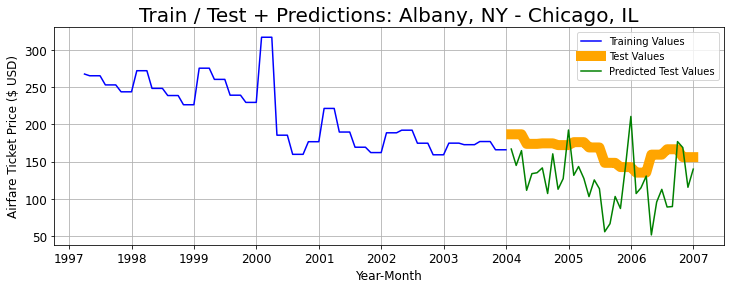

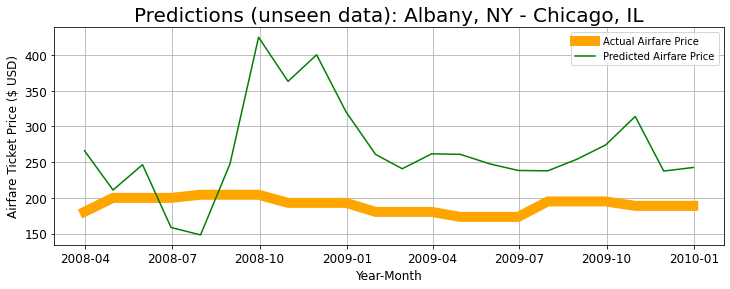

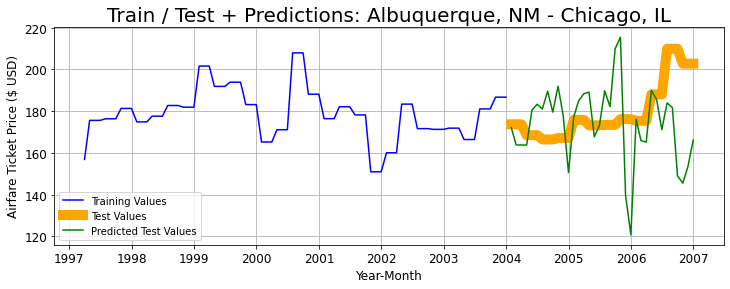

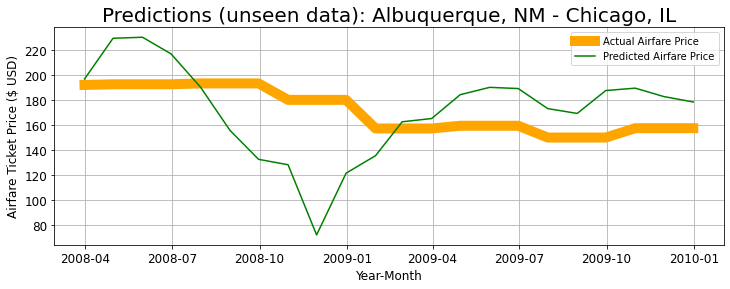

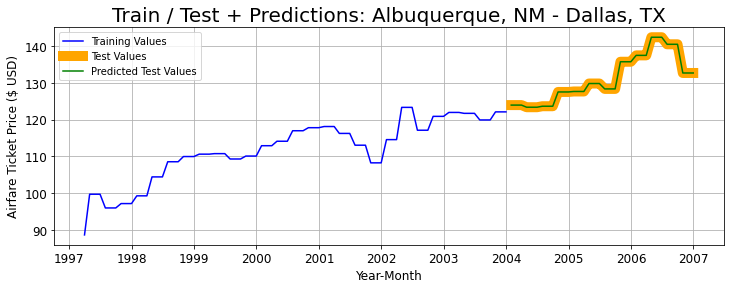

...

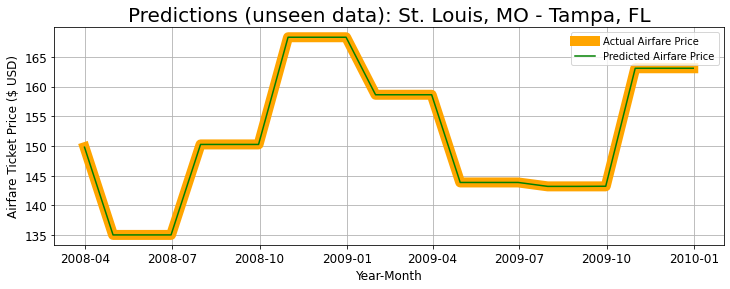

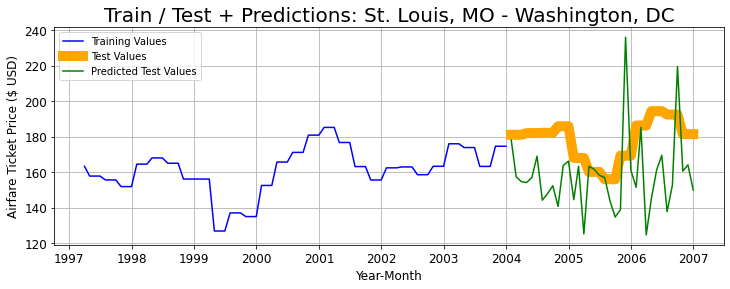

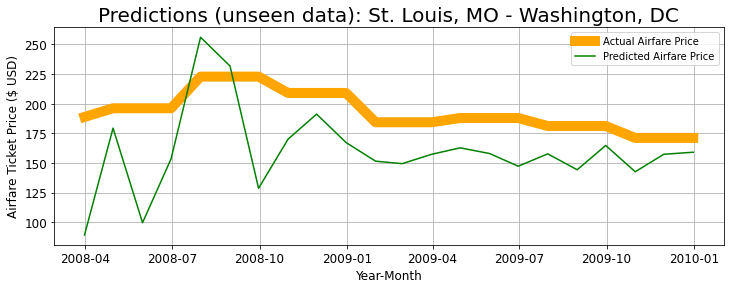

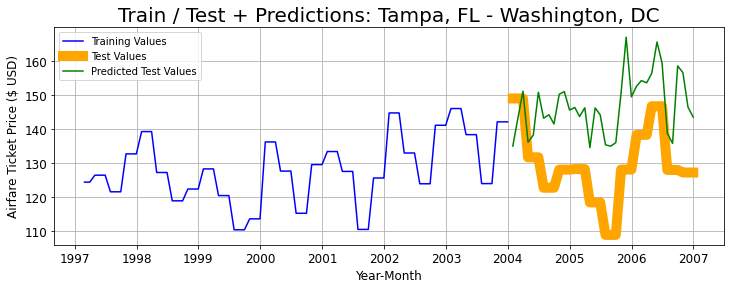

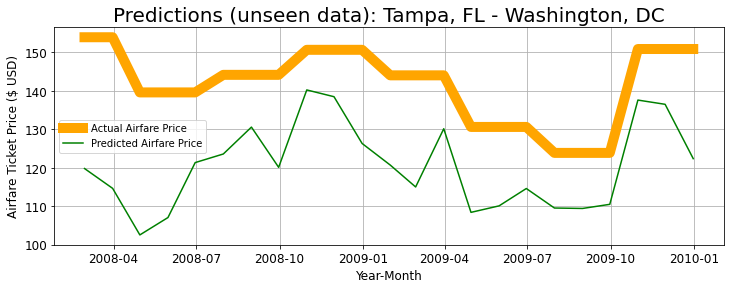

In [62]:
# let's run our code on our training data!  Let's loop through all of our routes and save the LINEAR MODEL & RESULTS ANALYTICS TO our all_route_dict

for rte in list(all_route_dict.keys()):
    all_route_dict[rte]['linear_model'], all_route_dict[rte]['model_results'] = build_linear_model(all_route_dict[rte]['train_dataframe'], all_route_dict[rte]['test_dataframe'], all_route_dict[rte]['potential_features'])

# LOOKING AT AN INDIVDUAL ROUTE FOR COMPARISON

In [532]:
# USE THIS TO RESTORE SHIT

all_route_dict = {}
for rte in ['Tampa, FL - Washington, DC']: # only looking at 10 routes right now
    route_dict = {}
    route_dict['route'] = rte
    route_dict['train_dataframe'] = df_read('./data/model/rtm_train_updated.csv', route=rte)[0]
    route_dict['test_dataframe'] = df_read('./data/model/rtm_test_updated.csv', route=rte)[0]
    route_dict['potential_features'] = df_read('./data/model/rtm_train_updated.csv', route=rte)[1]
    all_route_dict[rte] = route_dict

In [533]:
all_route_dict['Tampa, FL - Washington, DC'].keys()

dict_keys(['route', 'train_dataframe', 'test_dataframe', 'potential_features'])

In [534]:
def model_optimize_function(itinerary_route='Tampa, FL - Washington, DC', target_variable='airfare', pv_thresh=0.10):
    
    df = all_route_dict[itinerary_route]['train_dataframe']
    unseen_df = all_route_dict[itinerary_route]['test_dataframe']
    features_list = all_route_dict[itinerary_route]['potential_features']
    
    X = df[features_list]
    y = df[target_variable]
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, shuffle=False)
    X_train = sm.add_constant(X_train, has_constant='add')          
    X_test = sm.add_constant(X_test, has_constant='add')        
    X_train.dropna(inplace=True)                                     # dropping NA values to ensure model computes
    y_train = y_train[X_train.index]                                 # Subset y to match the index from X
    linear_model = sm.OLS(y_train, X_train).fit()
    
    X_unseen = unseen_df[features_list]                          # Create X variable with matching features from Traing Data
    X_unseen = sm.add_constant(X_unseen, has_constant='add')         # Add X Constant
    unseen_pred = linear_model.predict(X_unseen)                     # Make Predictions -- for 'airfare'
    unseen_df['airfare_predictions'] = unseen_pred   # save predictions to unseen route df
    unseen_df = unseen_df.dropna() 
    
    # Plot Train/Test & Model Predictions on Training Dataset
    plt.figure(figsize=(12, 4))                                                                # Set figure size
    plt.plot(y_train.index, y_train.values, color = 'blue', label='Training Values')           # Plot training data
    plt.plot(y_test.index, y_test.values, color = 'orange', label='Test Values', linewidth=10) # Plot testing data
    plt.plot(linear_model.predict(X_test), color = 'green', label='Predicted Test Values')                      # Plot predicted test values
    plt.title(label = 'Train / Test + Predictions: ' + str(itinerary_route), fontsize=20)            # Plot Title
    plt.ylabel('Airfare Ticket Price ($ USD)', size=12)                                        # Y Label
    plt.xlabel('Year-Month', size=12)                                                          # X label
    plt.grid()                                                                                 # add grid
    plt.xticks(fontsize=12)                                                                    # Resize X-Ticks
    plt.yticks(fontsize=12)                                                                    # Resize Y-Ticks
    plt.legend()                                                                               # Legend
    plt.savefig('./visualizations/' + itinerary_route + '_train.png', transparent=True, bbox_inches = "tight");    
    
    # Plot Predictions on our unseen dataframe
    plt.figure(figsize=(12, 4)) # Set figure size
    plt.plot(unseen_df['airfare'], color = 'orange', label='Actual Airfare Price', linewidth=10)    # Plot actual data.
    plt.plot(unseen_df['airfare_predictions'], color = 'green', label='Predicted Airfare Price')    # Plot predicted unseen values
    plt.title(label = 'Predictions (unseen data): ' + str(itinerary_route), fontsize=20) # add title
    plt.ylabel('Airfare Ticket Price ($ USD)', size=12)
    plt.xlabel('Year-Month', size=12)
    plt.grid()
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.legend()
    plt.savefig('./visualizations/' + itinerary_route + '_unseen.png', transparent=True, bbox_inches = "tight");    
    
    count = 1
    
    ###################
    model_dict = {}
    scoring_dict = {}
    score_dict = {}
    model_dict['lin_model_' + str(count)] = linear_model
    
    # ANALYTICS
    score_dict['y_train_pred'] = linear_model.predict(X_train) # Generate Predictions
    score_dict['y_test_pred'] = linear_model.predict(X_test) # Generate Predictions
    score_dict['y_test_baseline'] = [y_test.mean()] * len(y_test)  # Baseline
    score_dict['train_r2'] = r2_score(y_train, linear_model.predict(X_train))  # Scoring
    score_dict['train_rmse'] = mean_squared_error(y_train, linear_model.predict(X_train), squared=False) # Scoring
    score_dict['test_r2'] = r2_score(y_test, linear_model.predict(X_test)) # Scoring
    score_dict['test_rmse'] = mean_squared_error(y_test, linear_model.predict(X_test), squared=False) # Scoring
    score_dict['base_r2'] = r2_score(y_test, [y_test.mean()] * len(y_test)) # Scoring
    score_dict['base_rmse'] = mean_squared_error(y_test, [y_test.mean()] * len(y_test), squared=False) # Scoring
    score_dict['unseen_r2'] = r2_score(unseen_df[target_variable], unseen_df.airfare_predictions) # Scoring
    score_dict['unseen_rmse'] = mean_squared_error(unseen_df[target_variable], unseen_df.airfare_predictions, squared=False) # Scoring
    
    scoring_dict['analytics_' + str(count)] = score_dict
#     score_dict['analytics_' + str(count)] = score_dict
    ###################
    
    model_dict = {}
    scoring_dict = {}
    score_dict = {}

    removed_features_list = []
    condition = linear_model.pvalues.sort_values(ascending=False).max()
        
    while condition > pv_thresh:
        count +=1
        removed_features_list.append(linear_model.pvalues.sort_values(ascending=False).index[0])
        print(f'Removed: {linear_model.pvalues.sort_values(ascending=False).index[0]}')
        features_list = list(set(features_list) - set(removed_features_list))
        
        X = df[features_list]
        y = df['airfare']

        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, shuffle=False)
        X_train = sm.add_constant(X_train, has_constant='add')          
        X_test = sm.add_constant(X_test, has_constant='add')        
        X_train.dropna(inplace=True)                                     # dropping NA values to ensure model computes
        y_train = y_train[X_train.index]                                 # Subset y to match the index from X
        linear_model = sm.OLS(y_train, X_train).fit()
        
        condition = linear_model.pvalues.sort_values(ascending=False).max()
        
        X_unseen = unseen_df[features_list]                          # Create X variable with matching features from Traing Data
        X_unseen = sm.add_constant(X_unseen, has_constant='add')         # Add X Constant
        unseen_pred = linear_model.predict(X_unseen)                     # Make Predictions -- for 'airfare'
        unseen_df['airfare_predictions'] = unseen_pred   # save predictions to unseen route df
        unseen_df = unseen_df.dropna() 
        
        score_dict = {}
        # ANALYTICS
        score_dict['y_train_pred'] = linear_model.predict(X_train) # Generate Predictions
        score_dict['y_test_pred'] = linear_model.predict(X_test) # Generate Predictions
        score_dict['y_test_baseline'] = [y_test.mean()] * len(y_test)  # Baseline
        score_dict['train_r2'] = r2_score(y_train, linear_model.predict(X_train))  # Scoring
        score_dict['train_rmse'] = mean_squared_error(y_train, linear_model.predict(X_train), squared=False) # Scoring
        score_dict['test_r2'] = r2_score(y_test, linear_model.predict(X_test)) # Scoring
        score_dict['test_rmse'] = mean_squared_error(y_test, linear_model.predict(X_test), squared=False) # Scoring
        score_dict['base_r2'] = r2_score(y_test, [y_test.mean()] * len(y_test)) # Scoring
        score_dict['base_rmse'] = mean_squared_error(y_test, [y_test.mean()] * len(y_test), squared=False) # Scoring
        score_dict['unseen_r2'] = r2_score(unseen_df[target_variable], unseen_df.airfare_predictions) # Scoring
        score_dict['unseen_rmse'] = mean_squared_error(unseen_df[target_variable], unseen_df.airfare_predictions, squared=False) # Scoring
        scoring_dict['analytics_' + str(count)] = score_dict
        ###################
 
        model_dict['lin_model_' + str(count)] = linear_model
    
    all_route_dict[itinerary_route]['models'] = model_dict
    all_route_dict[itinerary_route]['analytics'] = scoring_dict
    all_route_dict[itinerary_route]['final_features'] = features_list
    all_route_dict[itinerary_route]['final_model'] = linear_model
    
    # Plot Predictions on our unseen dataframe
    plt.figure(figsize=(12, 4)) # Set figure size
    plt.plot(unseen_df['airfare'], color = 'orange', label='Actual Airfare Price', linewidth=10)    # Plot actual data.
    plt.plot(unseen_df['airfare_predictions'], color = 'green', label='Predicted Airfare Price')    # Plot predicted unseen values
    plt.title(label = 'Predictions (unseen data): ' + str(itinerary_route), fontsize=20) # add title
    plt.ylabel('Airfare Ticket Price ($ USD)', size=12)
    plt.xlabel('Year-Month', size=12)
    plt.grid()
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.legend()
    plt.savefig('./visualizations/' + itinerary_route + '_unseen_final.png', transparent=True, bbox_inches = "tight");

    return linear_model                    

Removed: sf_airfare_diff_1
Removed: passengers_per_flight
Removed: sf_seat_capacity_lag_1_diff_1
Removed: sf_seat_capacity_lag_2_diff_1
Removed: sf_flight_revenue_diff_1
Removed: sf_fuel_usd_pergallon_diff_1
Removed: flight_demand
Removed: sf_num_of_flights_lag_3_diff_1
Removed: passengers_per_flight_lag_12
Removed: sf_total_flight_cost_diff_1
Removed: sf_passengers_lag_12_diff_1
Removed: sf_flight_revenue_lag_12_diff_1
Removed: sf_fuel_usd_pergallon_lag_1_diff_1
Removed: sf_seat_capacity_diff_1
Removed: flight_demand_lag_1
Removed: sf_flight_demand_lag_12_diff_1


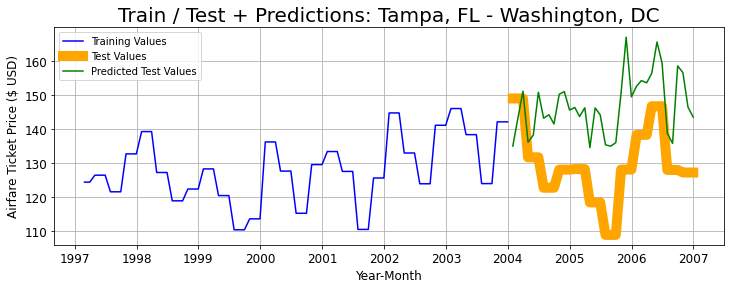

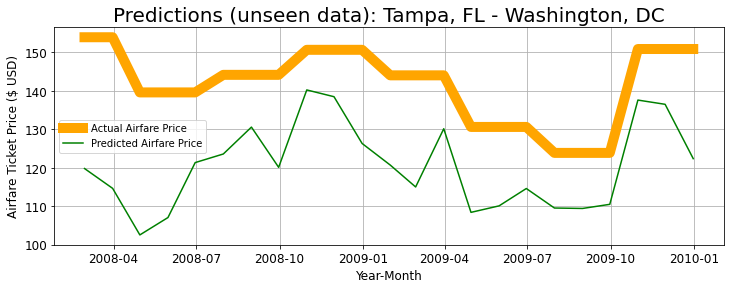

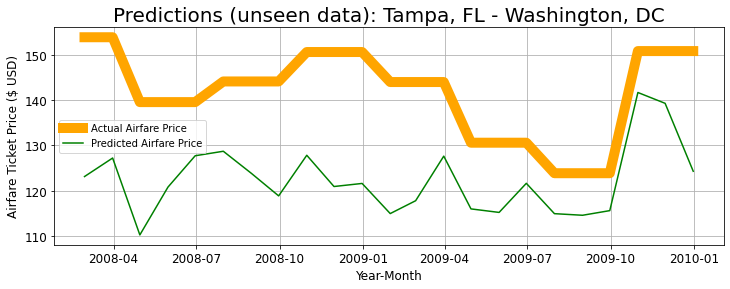

In [535]:
model_optimize_function()

In [538]:
all_route_dict['Tampa, FL - Washington, DC'].keys()
# all_route_dict['Tampa, FL - Washington, DC']['models'].keys()
all_route_dict['Tampa, FL - Washington, DC']['analytics'].keys()
all_route_dict['Tampa, FL - Washington, DC']['analytics']['analytics_17'].keys()

dict_keys(['y_train_pred', 'y_test_pred', 'y_test_baseline', 'train_r2', 'train_rmse', 'test_r2', 'test_rmse', 'base_r2', 'base_rmse', 'unseen_r2', 'unseen_rmse'])

### Model Scoring Dataframe
- This shows the output of the first modeling attempt (let's save the results!)

In [ ]:
model_results_df = pd.DataFrame()
for rte in list(all_route_dict.keys()):
    model_results_df = pd.concat([model_results_df, all_route_dict[rte]['model_results']])

model_results_df.reset_index(inplace=True)
model_results_df.drop(columns='index', inplace=True)

# Save to File
# model_results_df.to_csv('./data/analytics/ols_analytics_1.csv') # uncomment after saving!
print(model_results_df.shape)
model_results_df.head(2)


In [ ]:
model_results_df.describe()

In [ ]:
# r2 analytics - train vs test
model_results_df['train/test_r2_delta'] = model_results_df['test_r2'] - model_results_df['train_r2']
model_results_df['r2_overfit'] = model_results_df['train_r2'] > model_results_df['test_r2']

# rmse analytics - train vs test
model_results_df['train/test_rmse_delta'] = model_results_df['test_rmse'] - model_results_df['train_rmse']
model_results_df['rmse_overfit'] = model_results_df['train_rmse'] < model_results_df['test_rmse']


# r2 analytics - test vs unseen
model_results_df['test/unseen_r2_delta'] = model_results_df['unseen_r2'] - model_results_df['test_r2']
model_results_df['unseen_outperforms_r2'] = ['Outperforms' if i > 0 else 'Underperforms' for i in model_results_df['test/unseen_r2_delta']]

# rmse analytics - test vs unseen
model_results_df['test/unseen_rmse_delta'] = model_results_df['unseen_rmse'] - model_results_df['test_rmse']
model_results_df['unseen_outperforms_rmse'] = ['Outperforms' if i > 0 else 'Underperforms' for i in model_results_df['test/unseen_rmse_delta']]

# model_results_df.drop(columns=['overfit/underfit_rmse', 'overfit/underfit_r2'], inplace=True)

model_results_df.head()

In [ ]:
# % of models overfit according to R2
model_results_df['r2_overfit'].value_counts(normalize=True)

In [ ]:
# % of models overfit according to RMSE
model_results_df['rmse_overfit'].value_counts(normalize=True)

In [ ]:
# There is a number of routes our models do not play nice with - 359 out of 375 :( :(
print(model_results_df[model_results_df['rmse_overfit'] == True].sort_values('test_r2').shape[0])
model_results_df[model_results_df['rmse_overfit'] == True].sort_values('test_r2').head()

In [ ]:
# These models play nice with - 16 out of 375 :( :(
print(model_results_df[model_results_df['rmse_overfit'] == False].sort_values('test_rmse', ascending=False).shape[0])
model_results_df[model_results_df['rmse_overfit'] == False].sort_values('test_rmse', ascending=False).head(5)

# VAR MODEL BELOW

### Let's try another model to see if we can do better with the routes that our model is having difficulty with

In [ ]:
from statsmodels.tsa.vector_ar.vecm import VAR

# These 16 routes are the worst performers -  selected
ols_results[(ols_results['overfit/underfit'] == 'Overfit')].sort_values('train/test_r2_%_delta').head(16)
ols_results[(ols_results['overfit/underfit'] == 'Overfit')].sort_values('train/test_r2_%_delta').head(16).route

In [ ]:
sorted(train.columns)

In [ ]:
final_features

In [ ]:
test_features = [
 'sf_airfare_diff_1',
 'sf_cost_per_mile_diff_1',
#  'sf_fuel_usd_pergallon_diff_1',
 'sf_num_of_flights_diff_1',
 'sf_passengers_diff_2',
 'sf_passengers_per_flight_diff_2',
 'dist_miles'
]

In [ ]:
parameters = ['passengers', 'seat_capacity', 'num_of_flights', 'dist_miles', 'airfare', 'fuel_usd_pergallon', 'total_flight_miles', 
              'total_flight_cost', 'flight_demand', 'cost_per_mile', 'flight_revenue', 'passengers_per_flight']

def read_route(df, itinerary='Dallas, TX - Houston, TX', params=parameters, maxlags_int=15, test_size_float = 0.25, ic_string='aic', trend_string='c'):
    
    df = df[df['route'] == itinerary].copy()
    
    train, test = train_test_split(df[params], test_size = test_size_float, shuffle=False, random_state=1983)
    
    model = VAR(train).fit(maxlags = maxlags_int, ic = ic_string, trend = trend_string)
    
    print(f'What is the order of our autoregressive model: {model.k_ar}')
    print(model.summary())

    return itinerary, model, df, train, test

In [ ]:
route_itinerary, var_model, var_df, var_train, var_test = read_route(train, itinerary='New York, NY - Orlando, FL', maxlags_int=1, params=test_features)

In [ ]:
print(route_itinerary)
var_model.plot_acorr();

In [ ]:
print(var_df.shape)
print(var_train.shape)
print(var_test.shape)

In [ ]:
train[['airfare', 'sf_airfare_diff_1', 'route']][train['route'] == 'Atlanta, GA - Columbus, OH']

In [ ]:
var_df['airfare'].diff()

In [ ]:
var_df[['airfare', 'sf_airfare_diff_1']].head()

In [ ]:
airfare_reverse = []
for amount in var_df['sf_airfare_diff_1']:
    airfare_reverse =

In [ ]:
print(route_itinerary)
var_model.plot_forecast(12, plot_stderr=False)
# plt.legend(loc='best')
;

In [ ]:
var_train

In [ ]:
print(route_itinerary)
var_model.k_ar

In [ ]:
print(route_itinerary)
var_model.forecast(y=var_train.values, steps=3)

In [ ]:
print(route_itinerary)
var_model.forecast(y=var_test.values, steps=3)

In [ ]:
var_model.irf(3).plot(orth=False);

In [ ]:
var_model.irf(3).plot_cum_effects(orth=False); # https://notes.quantecon.org/submission/5db25b54831cf4001af7e506